In [43]:
import os
import pandas as pd
import numpy as np
import plotly.express as px
import seaborn as sns
import json
import warnings

In [44]:
pd.set_option('max_columns', 101)
sns.set_theme()

In [45]:
EXPERIMENT_ID = 81

In [46]:
BASE_DIR = fr'..\..\..\data\dynamic_simulations\experiment_{EXPERIMENT_ID}'
BASE_DIR

'..\\..\\..\\data\\dynamic_simulations\\experiment_81'

In [47]:
os.listdir(BASE_DIR)

['0',
 '1',
 '10',
 '100',
 '101',
 '102',
 '103',
 '104',
 '105',
 '106',
 '107',
 '11',
 '12',
 '13',
 '14',
 '15',
 '16',
 '17',
 '18',
 '19',
 '2',
 '20',
 '21',
 '22',
 '23',
 '24',
 '25',
 '26',
 '27',
 '28',
 '29',
 '3',
 '30',
 '31',
 '32',
 '33',
 '34',
 '35',
 '36',
 '37',
 '38',
 '39',
 '4',
 '40',
 '41',
 '42',
 '43',
 '44',
 '45',
 '46',
 '47',
 '48',
 '49',
 '5',
 '50',
 '51',
 '52',
 '53',
 '54',
 '55',
 '56',
 '57',
 '58',
 '59',
 '6',
 '60',
 '61',
 '62',
 '63',
 '64',
 '65',
 '66',
 '67',
 '68',
 '69',
 '7',
 '70',
 '71',
 '72',
 '73',
 '74',
 '75',
 '76',
 '77',
 '78',
 '79',
 '8',
 '80',
 '81',
 '82',
 '83',
 '84',
 '85',
 '86',
 '87',
 '88',
 '89',
 '9',
 '90',
 '91',
 '92',
 '93',
 '94',
 '95',
 '96',
 '97',
 '98',
 '99',
 'actions.txt',
 'config.json']

In [48]:
X_NAME = 'X'
Y_NAME = 'Y'

TOKEN_0 = X_NAME
TOKEN_1 = Y_NAME

In [49]:
class Simulation:
    def __init__(self,):
        self.occ_min = None
        self.initial_reserve_usd = None
        self.ratio_sec_usd = None
        self.amount_in_std = None
        self.amount_in_Y_std = None
      #  self.blo
    

In [50]:
def find_longest_blocked_sequence(s: pd.Series):
    cnt = 0
    max_cnt = 0
    
    for index, value in s.items():
        if value != 'SUCCESS':
            cnt += 1
        else:
            max_cnt = max(max_cnt, cnt)
            cnt = 0
    
    return max(max_cnt, cnt)

In [51]:
def read_simulation_stats(folder):
    simulation = {}
    
    config_filename = os.path.join(folder, 'config.json')
    swaps_filename = os.path.join(folder, 'swaps_normalized.csv')
    pool_state_filename = os.path.join(folder, 'pool_after_transaction_normalized.csv')
    
    with open(config_filename) as f:
        simulation = json.loads(f.read())
            
    pool_state_df = pd.read_csv(pool_state_filename)
    swaps_df = pd.read_csv(swaps_filename)
    
 #   simulation['id'] = simulation_id

    #print(swaps_filename)
    #print(swaps_df.shape)
    #print(swaps_df.status.value_counts())
    swaps_df = swaps_df[swaps_df.status != 'PENDING']
        
    simulation['count'] = swaps_df.shape[0]
    simulation['blocked_transactions'] = (swaps_df.status != 'SUCCESS').sum()
    simulation['blocked_transactions_pct'] = simulation['blocked_transactions']/len(swaps_df)

    simulation['blocked_by_volatility_mitigator'] = (swaps_df.status == 'BLOCKED_BY_VOLATILITY_MITIGATION').sum()
    simulation['blocked_by_volatility_mitigator_pct'] = simulation['blocked_by_volatility_mitigator'] / simulation['blocked_transactions'] if simulation['blocked_transactions'] else None

    simulation['blocked_exceeded_slippage'] = (swaps_df.status == 'EXCEEDED_MAX_SLIPPAGE').sum()
    simulation['blocked_exceeded_slippage_pct'] = simulation['blocked_exceeded_slippage'] / simulation['blocked_transactions'] if simulation['blocked_transactions'] else None
    
    simulation['blocked_not_enough_reserves'] = (swaps_df.status == 'NOT_ENOUGH_RESERVES').sum()
    simulation['blocked_not_enough_reserves_pct'] = simulation['blocked_not_enough_reserves'] / simulation['blocked_transactions'] if simulation['blocked_transactions'] else None
    
    simulation['longest_blocked_sequence'] = find_longest_blocked_sequence(swaps_df.status)
    simulation['longest_blocked_sequence_pct'] = simulation['longest_blocked_sequence'] / len(swaps_df) if simulation['blocked_transactions'] else None
    
    simulation['blocked_k_error'] = (swaps_df.status == 'K_ERROR').sum()
    simulation['blocked_k_error_pct'] = simulation['blocked_k_error'] / simulation['blocked_transactions'] if simulation['blocked_transactions'] else None
    
    simulation['amount_in_Y_std_success'] = swaps_df.loc[(swaps_df.token_in == Y_NAME) & (swaps_df.status == 'SUCCESS'), 'token_in_amount'].std()
    simulation['max_X_in_success'] = swaps_df.loc[(swaps_df.token_in == X_NAME) & (swaps_df.status == 'SUCCESS')].token_in_amount.max()
    simulation['max_Y_in_success'] = swaps_df.loc[(swaps_df.token_in == Y_NAME) & (swaps_df.status == 'SUCCESS')].token_in_amount.max()

    simulation['max_X_out_success'] = swaps_df.loc[(swaps_df.token_in == Y_NAME) & (swaps_df.status == 'SUCCESS')].token_out_amount.max()
    simulation['max_Y_out_success'] = swaps_df.loc[(swaps_df.token_in == X_NAME) & (swaps_df.status == 'SUCCESS')].token_out_amount.max()
    
    
    simulation['mean_X_in_success'] = swaps_df.loc[(swaps_df.token_in == X_NAME) & (swaps_df.status == 'SUCCESS')].token_in_amount.mean()
    simulation['mean_Y_in_success'] = swaps_df.loc[(swaps_df.token_in == Y_NAME) & (swaps_df.status == 'SUCCESS')].token_in_amount.mean()
    
    simulation['mean_X_out_success'] = swaps_df.loc[(swaps_df.token_in == Y_NAME) & (swaps_df.status == 'SUCCESS')].token_out_amount.mean()
    simulation['mean_Y_out_success'] = swaps_df.loc[(swaps_df.token_in == X_NAME) & (swaps_df.status == 'SUCCESS')].token_out_amount.mean()
    
    
    simulation['price_X_std'] = (pool_state_df['reserve_Y'] / pool_state_df['reserve_X']).std()
    simulation['price_Y_std'] = (pool_state_df['reserve_X'] / pool_state_df['reserve_Y']).std()
    
    g = swaps_df.groupby(['token_in', 'status']).size()
    simulation['success_X_in_ratio'] = g.loc[(X_NAME, 'SUCCESS')] /  g.loc[(Y_NAME, 'SUCCESS')]
    
    simulation['shape'] = float(simulation['shape'])
    simulation['scale'] = float(simulation['scale'])
    simulation['initial_reserve_usd'] = float(simulation['initial_reserve_usd'])
    
    return simulation

In [52]:
def read_config(config_filename):
    config = {}
    
    with open(config_filename) as f:
        return json.loads(f.read())

In [53]:
def remove_initial_swaps(df, initial_time_seconds):
    min_time = df.transaction_timestamp.min() + initial_time_seconds
    
    return df[df.transaction_timestamp >= min_time]

In [54]:
import datetime

def _read_simulation(folder:str):
    pool_state_before_transactions_path = os.path.join(folder, 'pool_before_transaction_normalized.csv')
    pool_state_after_transactions_path = os.path.join(folder, 'pool_after_transaction_normalized.csv')
    swap_transactions_path = os.path.join(folder, 'swaps_normalized.csv')
    config_path = os.path.join(folder, 'config.json')
        
    # read swaps
    pool0_df = pd.read_csv(pool_state_before_transactions_path)
    pool1_df = pd.read_csv(pool_state_after_transactions_path)
    swaps_df = pd.read_csv(swap_transactions_path)
    config = read_config(config_path)
    stats = read_simulation_stats(folder)
    
    pool0_df.columns = pool0_df.columns.map(lambda x : x + '_before' if x != 'transaction_id' else x)
    
    swaps_df = remove_initial_swaps(swaps_df, 24*60*60)

    swaps_df = pd.merge(swaps_df, pool0_df, left_on='id', right_on='transaction_id')
    swaps_df = pd.merge(swaps_df, pool1_df, left_on='transaction_id', right_on='transaction_id')
    
    swaps_df['transaction_timestamp'] = pd.to_datetime(swaps_df.transaction_timestamp, unit='s')
    swaps_df['block_timestamp'] = pd.to_datetime(swaps_df.block_timestamp, unit='s')
    
    swaps_df.loc[:, 'X_price'] = swaps_df['reserve_Y'] / swaps_df['reserve_X']
    
    # price impact of swap / 100%
    swaps_df.loc[:, 'price_diff'] = (swaps_df['reserve_Y'] / swaps_df['reserve_X'] - swaps_df['reserve_Y_before'] / swaps_df['reserve_X_before']) / (swaps_df['reserve_Y_before'] / swaps_df['reserve_X_before'])
    
    #print('RS', swap_transactions_path)
    #print('RS', swaps_df.shape)
    
    return swaps_df, config, stats

In [55]:
def read_simulation_iter(folder, iteration_id):
    '''
    At each iteration 2 simulation are being performed: with volatility mitigation mechanism disabled and enabled
    '''
    sim0 = _read_simulation(os.path.join(folder, '0'), )
    sim1 = _read_simulation(os.path.join(folder, '1'))
    
    return sim0, sim1

In [56]:
simulations = []
config_list = []
stats_list = []

cnt = 0
for i, simulation_id in enumerate(os.listdir(BASE_DIR)):
    if simulation_id.endswith('.json') or simulation_id.endswith('.csv') or simulation_id.endswith('.txt'): # todo: continue if any file
        continue
        
    sim_path = os.path.join(BASE_DIR, simulation_id)
    
    sim0, sim1 = read_simulation_iter(sim_path, simulation_id)
    sim0[2]['sim_index'] = 2*i
    sim1[2]['sim_index'] = 2*i + 1
    
    simulations.extend([sim0[0], sim1[0]])
    config_list.extend([sim0[1], sim1[1]])
    stats_list.extend([sim0[2], sim1[2]])

In [57]:
config_df = pd.DataFrame.from_records(config_list)
stats_df = pd.DataFrame.from_records(stats_list)

In [58]:
filtered_stats_df = stats_df[(stats_df['volatility_mitigator'] == True) ].copy()
filtered_stats_df

,window_size,granularity,price_tollerance_threshold,initial_reserve_usd,volatility_mitigator,shape,scale,count,blocked_transactions,blocked_transactions_pct,blocked_by_volatility_mitigator,blocked_by_volatility_mitigator_pct,blocked_exceeded_slippage,blocked_exceeded_slippage_pct,blocked_not_enough_reserves,blocked_not_enough_reserves_pct,longest_blocked_sequence,longest_blocked_sequence_pct,blocked_k_error,blocked_k_error_pct,amount_in_Y_std_success,max_X_in_success,max_Y_in_success,max_X_out_success,max_Y_out_success,mean_X_in_success,mean_Y_in_success,mean_X_out_success,mean_Y_out_success,price_X_std,price_Y_std,success_X_in_ratio,sim_index
1,24,24,98,500.0,True,0.638833,8.151783,4726,3,0.000635,3,1.0,0,0.0,0,0.0,1,0.000212,0,0.0,15.771938,158.536326,163.991048,280.951710,218.963535,8.557357,9.818174,8.100052,10.059190,1.879562,0.923782,0.974498,1
3,24,24,98,500.0,True,0.764369,0.267990,4831,0,0.000000,0,NaN,0,NaN,0,NaN,0,NaN,0,NaN,0.403882,4.780490,4.239989,4.391928,7.943284,0.291716,0.283859,0.246389,0.312851,0.295509,0.254520,1.025577,3
5,24,24,98,500.0,True,1.515610,105.385226,4585,67,0.014613,67,1.0,0,0.0,0,0.0,2,0.000436,0,0.0,45.361131,299.555227,296.143400,524.644722,1011.968632,51.936800,58.685587,50.472690,59.210155,2.340094,1.244370,0.981579,5
7,24,24,98,505000000.0,True,0.688164,12877.194871,4907,0,0.000000,0,NaN,0,NaN,0,NaN,0,NaN,0,NaN,22441.584632,337150.163677,216126.798702,206539.171235,336846.707828,14605.550503,14638.847571,14320.203124,14618.941910,0.013596,0.013239,1.050564,7
9,24,24,98,505000000.0,True,0.753655,10508.731121,4781,0,0.000000,0,NaN,0,NaN,0,NaN,0,NaN,0,NaN,16991.340485,161232.196927,149715.199408,142414.980909,164054.196285,11194.717048,11585.916589,11273.799013,11272.553668,0.013158,0.012720,1.029287,9
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
207,24,24,98,5500000.0,True,1.468466,26106.506213,4798,0,0.000000,0,NaN,0,NaN,0,NaN,0,NaN,0,NaN,16877.496105,95719.162067,114577.427042,217794.804266,259417.704228,20782.320108,21160.005776,18993.600403,22408.372653,0.892657,0.627952,0.958367,207
209,24,24,98,505000000.0,True,0.461378,4719.153066,4787,0,0.000000,0,NaN,0,NaN,0,NaN,0,NaN,0,NaN,25799.449079,424883.812986,340447.867526,333901.135628,433393.123129,10099.589750,10186.680547,9946.475461,10138.527719,0.010700,0.010392,0.984660,209
211,24,24,98,505000000.0,True,0.526868,2350.689317,4741,0,0.000000,0,NaN,0,NaN,0,NaN,0,NaN,0,NaN,7428.482968,152355.309168,109452.056232,107955.789393,152751.551513,3600.710312,3752.418455,3691.871429,3587.756036,0.004169,0.004120,0.990344,211
213,24,24,98,505000000.0,True,0.628650,2350.689317,4735,0,0.000000,0,NaN,0,NaN,0,NaN,0,NaN,0,NaN,5164.643908,66096.589951,60358.764612,59589.369156,66057.569181,3232.769115,2979.180293,2936.037601,3213.868518,0.003305,0.003277,0.976210,213


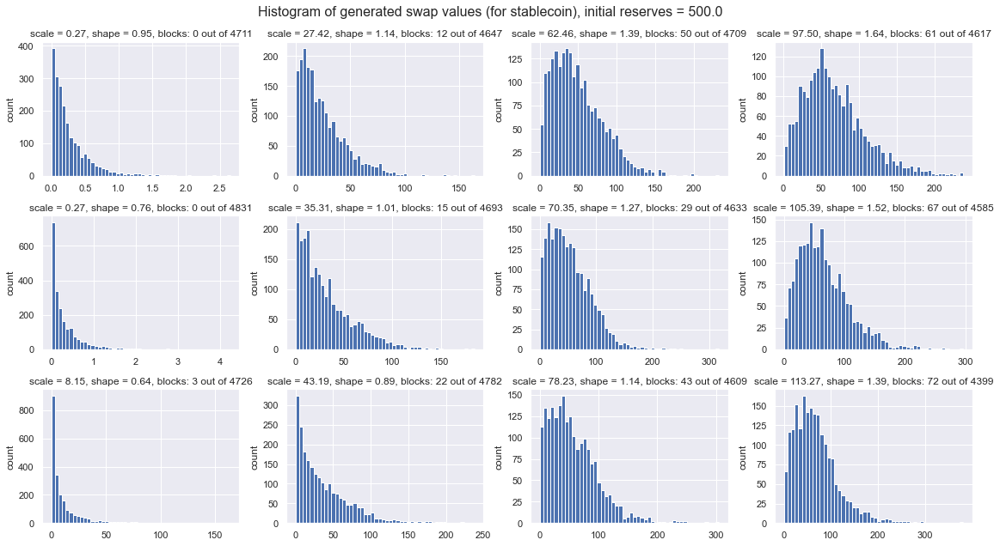

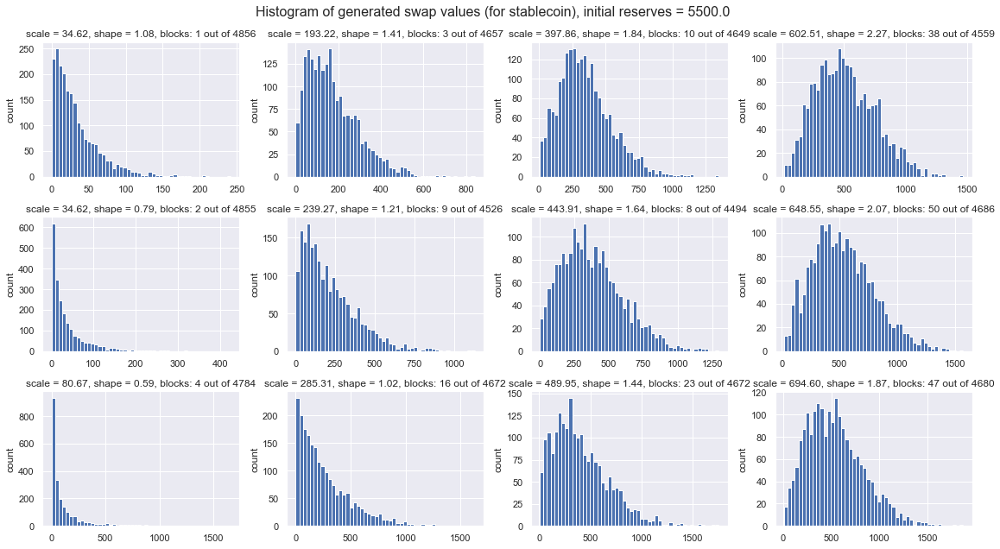

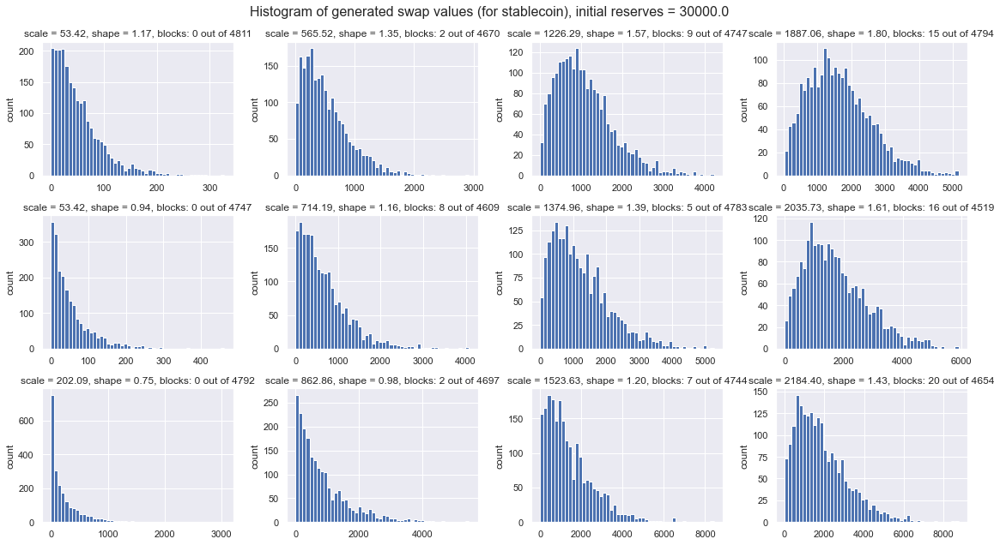

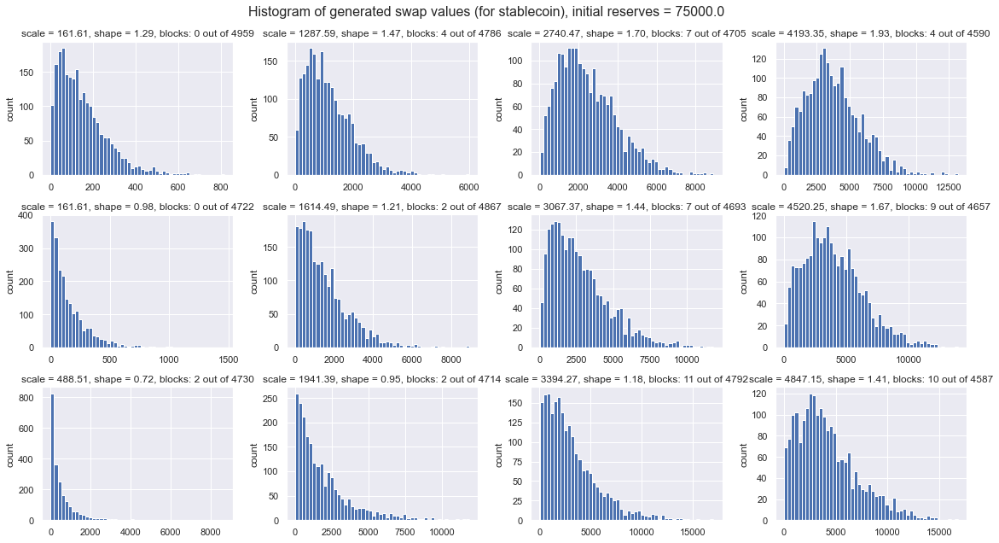

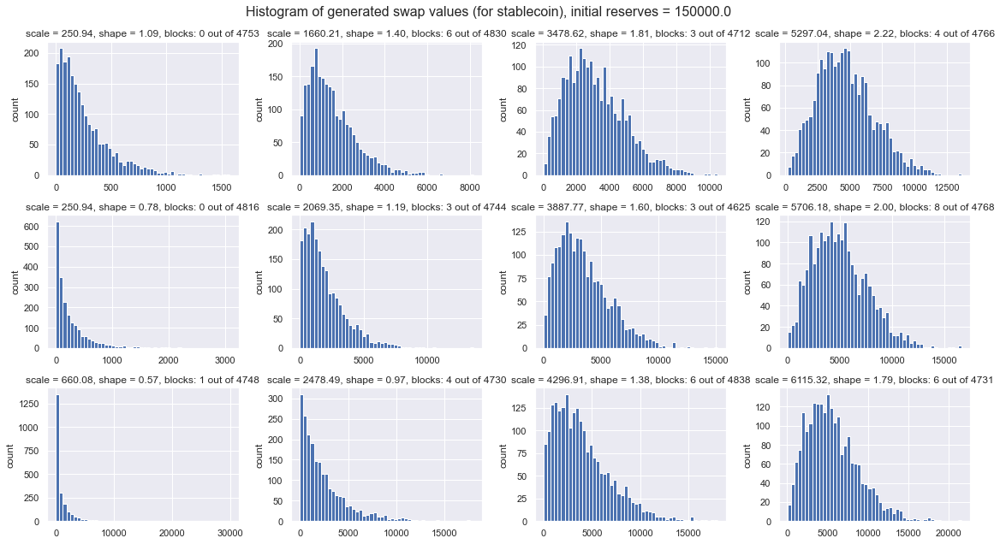

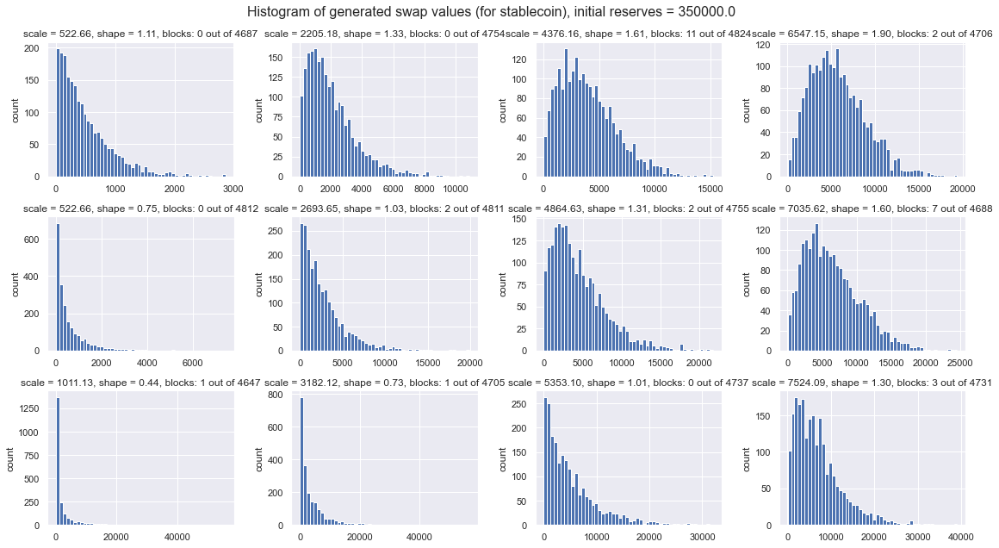

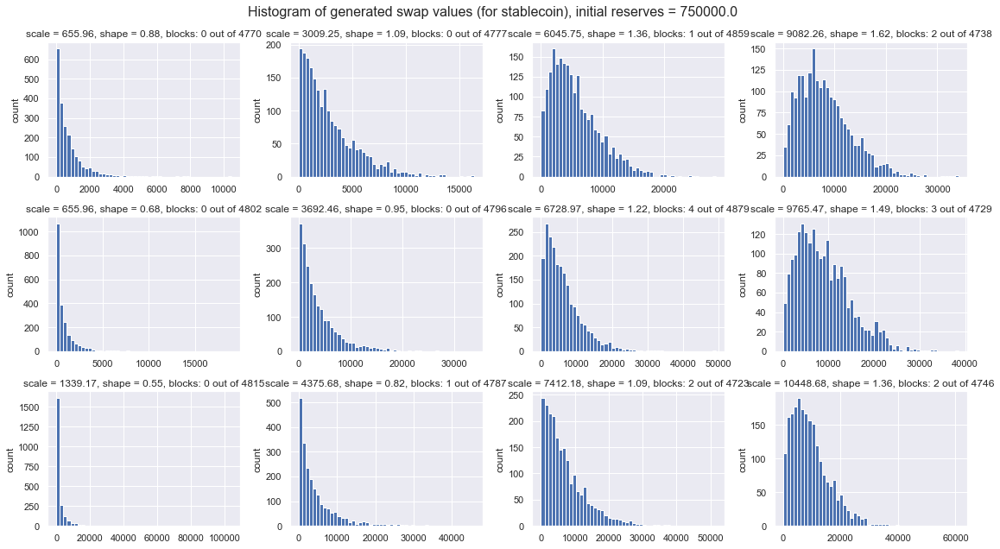

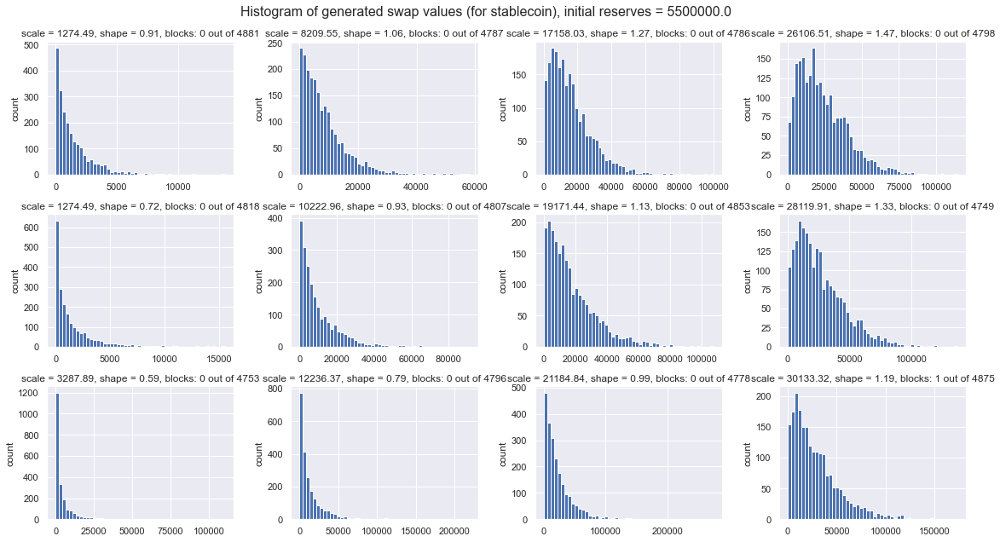

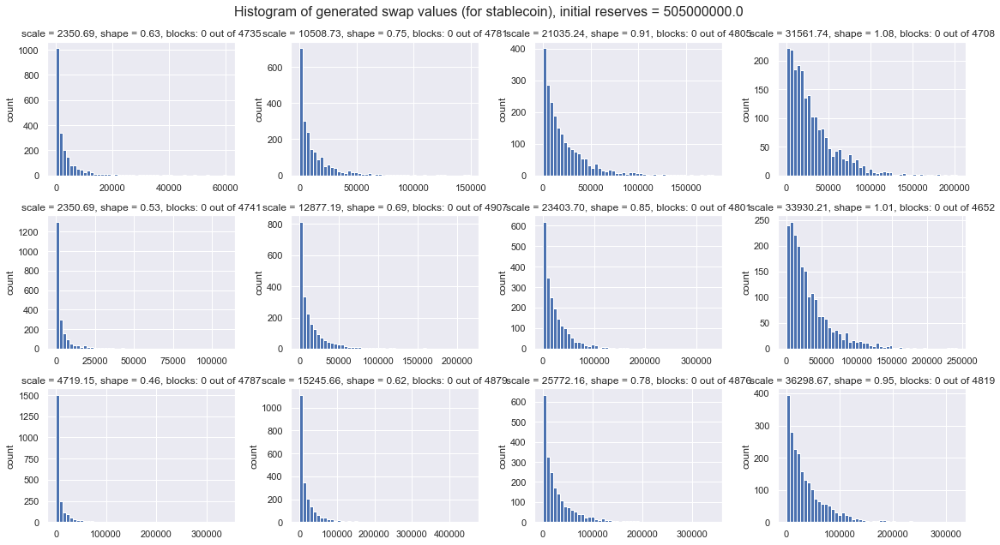

In [59]:
import matplotlib.pyplot as plt



filtered_stats_df.sort_values(by=['initial_reserve_usd', 'scale', 'shape'], inplace=True, ascending=[True, True, False])
reserve_groups = filtered_stats_df.groupby('initial_reserve_usd')

for name, curr_reserve_stats_df in reserve_groups:
    N = len(curr_reserve_stats_df)
    COLS = 4
    ROWS = N//COLS + (N%COLS != 0)

    fig, ax = plt.subplots(ROWS, COLS, figsize=(COLS*4, ROWS*3))
    axes = ax.ravel()
    axes = axes.reshape(ROWS, COLS).T.ravel()
    
    i = 0
    for index, row in curr_reserve_stats_df.iterrows():
        ax = axes[i]

        scale, shape, initial_reserves_usd, blocks, count = row['scale'], row['shape'], row['initial_reserve_usd'], row['blocked_transactions'], row['count']

        df = simulations[row['sim_index']]

        values = df[df.token_in == 'Y'].token_in_amount.copy()
        ax.hist(values, bins=50)

        ax.set_ylabel('count')
        ax.set_title(f'scale = {scale:.2f}, shape = {shape:.2f}, blocks: {blocks} out of {count}') #todo: iloc may differ from simulatuions df

        i += 1

    fig.suptitle(f'Histogram of generated swap values (for stablecoin), initial reserves = {name}', fontsize=16)
    fig.tight_layout()


In [61]:
def show_title(ax, stats_s, show_legend=False):
    scale, shape, initial_reserves_usd = row['scale'], row['shape'], row['initial_reserve_usd']
    blocks, blocks_vm, blocks_slippage, count = row['blocked_transactions'], row['blocked_by_volatility_mitigator'], row['blocked_exceeded_slippage'], row['count']

    ax.set_title(f'scale: {scale:.2f}, shape: {shape:.2f}, swaps: {count}\nblocks by vm / slippage: {blocks_vm/count*100:.1f}%/{blocks_slippage/count*100:.1f}%') #todo: iloc may differ from simulatuions df
    fig.autofmt_xdate()

    if show_legend:
        fig.legend()

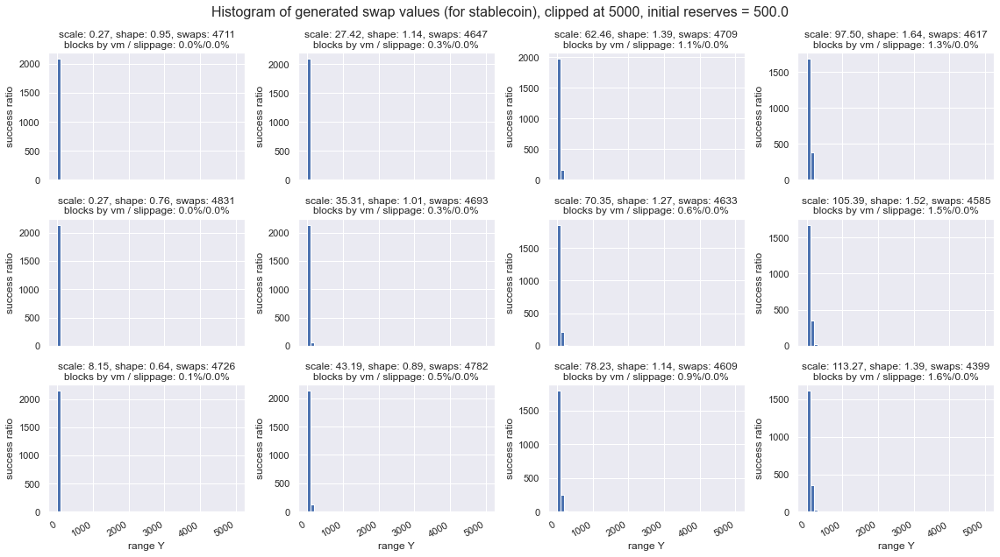

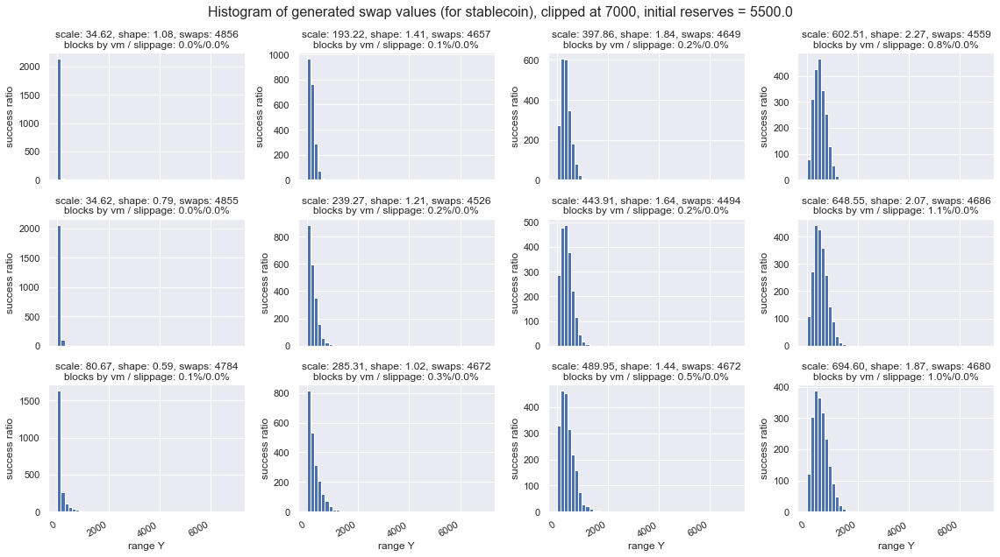

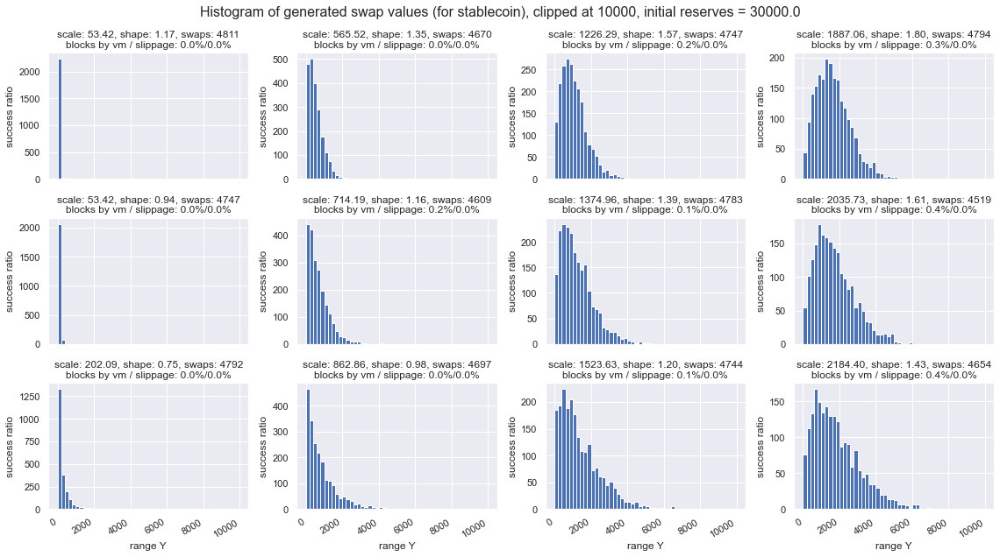

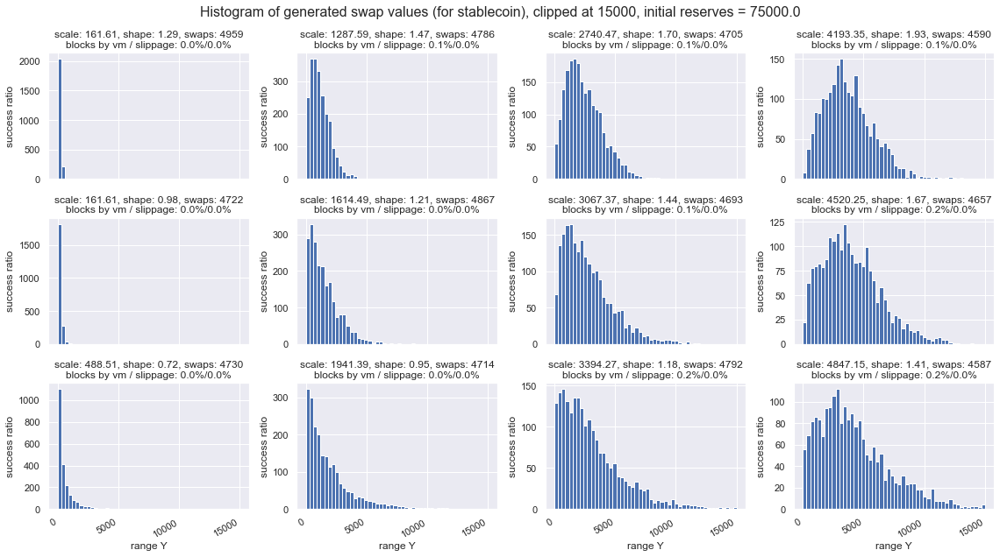

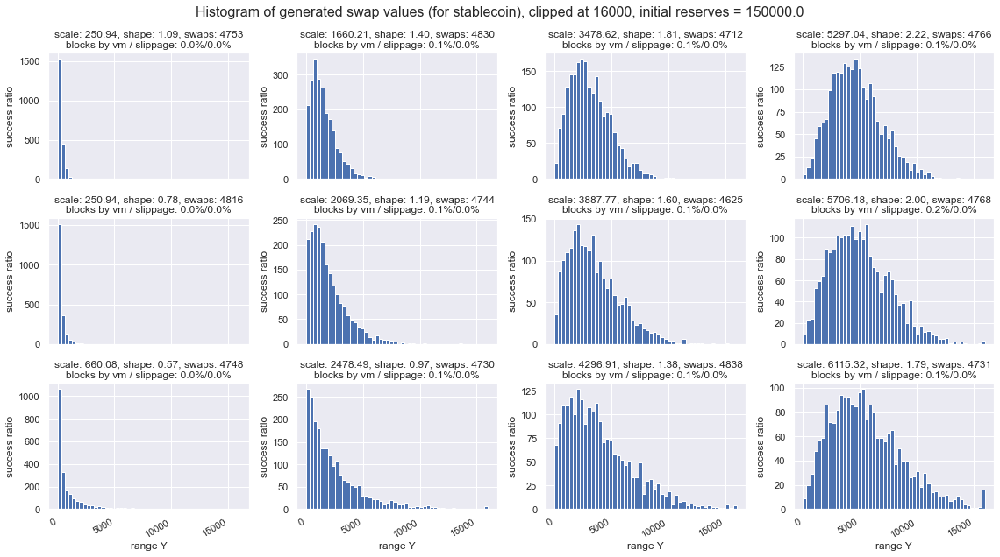

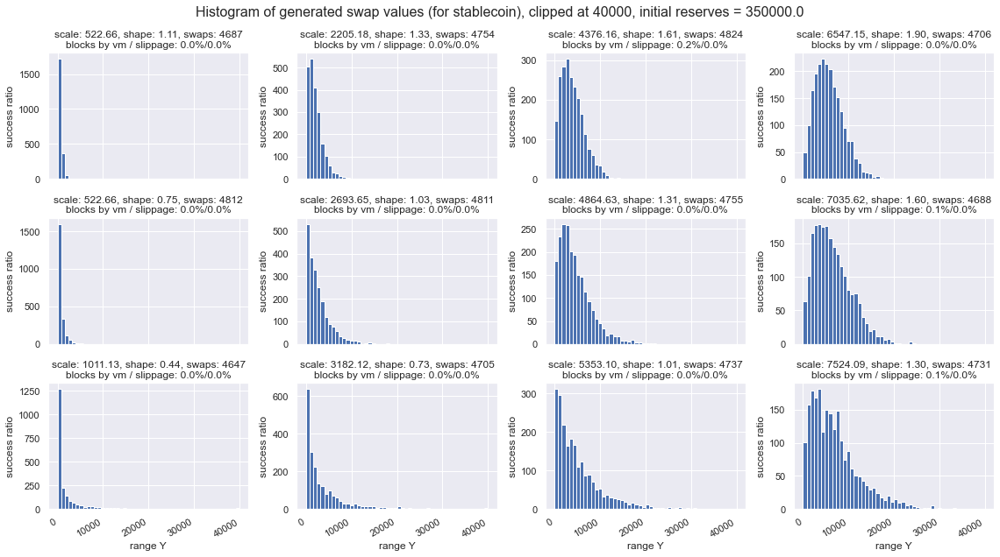

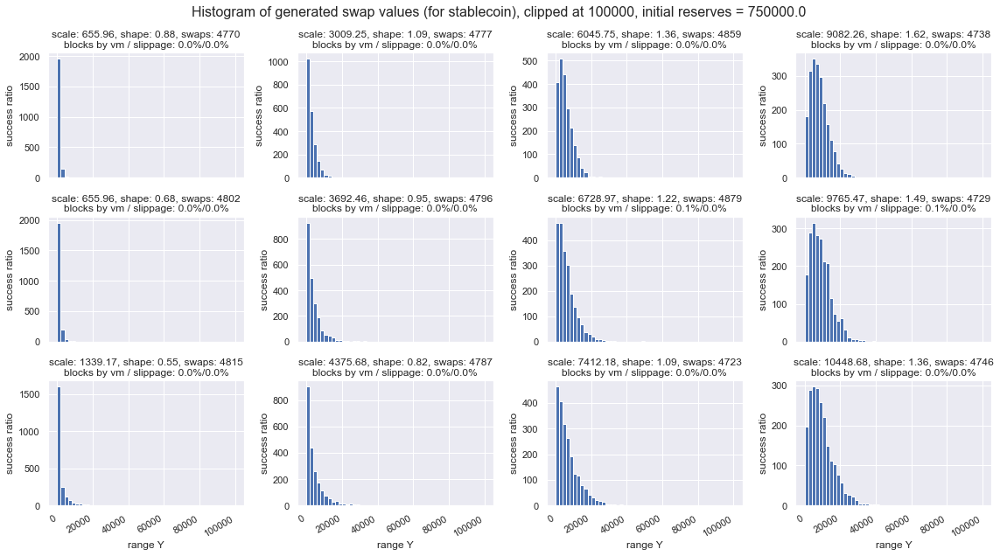

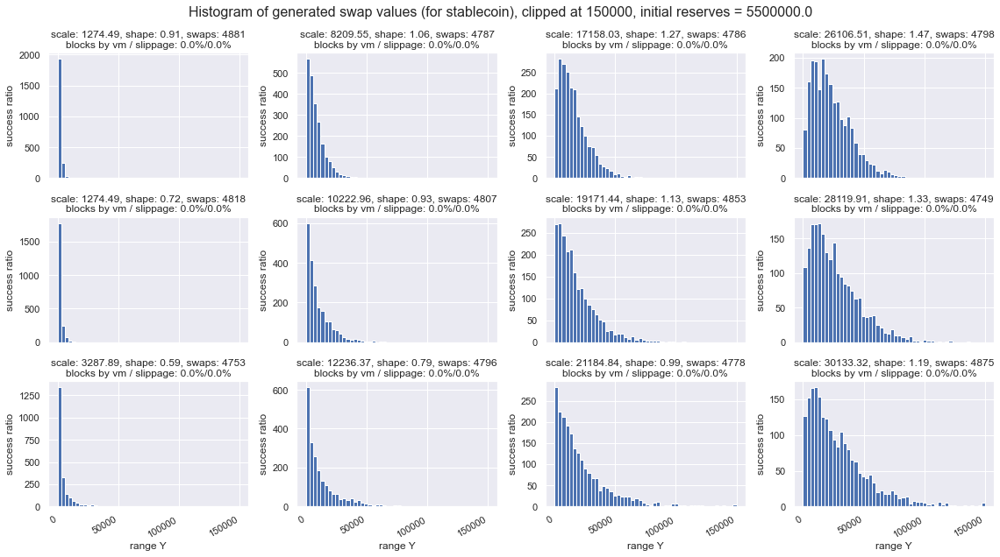

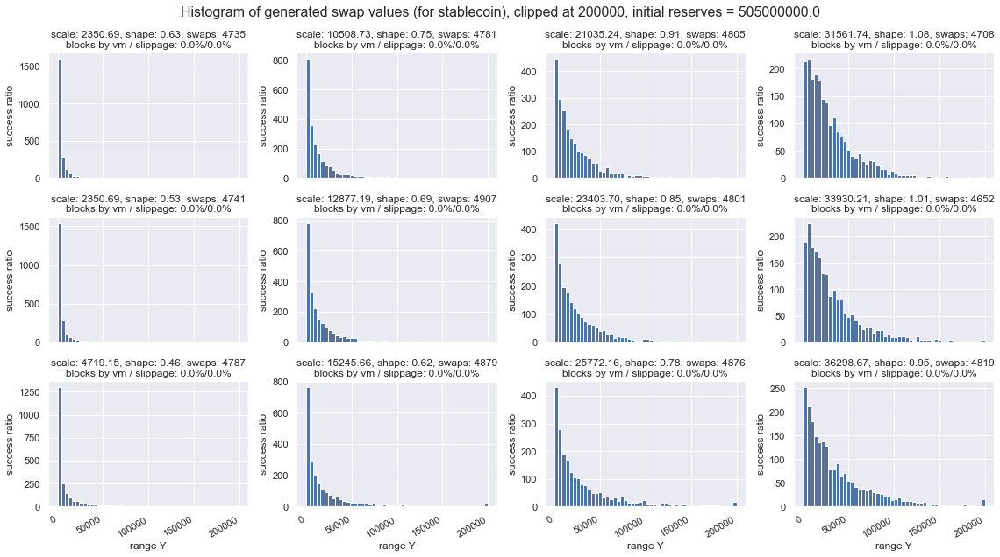

In [62]:
import matplotlib.pyplot as plt

x_upper_limits = [5000, 7000, 10000, 15000, 16000, 40000, 100000, 150000, 200000]

filtered_stats_df.sort_values(by=['initial_reserve_usd', 'scale', 'shape'], inplace=True, ascending=[True, True, False])
reserve_groups = filtered_stats_df.groupby('initial_reserve_usd')

j = 0
for name, curr_reserve_stats_df in reserve_groups:
    N = len(curr_reserve_stats_df)
    COLS = 4
    ROWS = N//COLS + (N%COLS != 0)

    fig, ax = plt.subplots(ROWS, COLS, figsize=(COLS*4, ROWS*3))
    axes = ax.ravel()
    axes = axes.reshape(ROWS, COLS).T.ravel()
    
    i = 0
    for index, row in curr_reserve_stats_df.iterrows():
        ax = axes[i]

        scale, shape, initial_reserves_usd, blocks, count = row['scale'], row['shape'], row['initial_reserve_usd'], row['blocked_transactions'], row['count']

        df = simulations[row['sim_index']]

        values = df[df.token_in == 'Y'].token_in_amount.copy()
        upper_limit = x_upper_limits[j]
        values[values > upper_limit] = upper_limit
        ax.hist(values, bins=50, range=(0, upper_limit))

     #   ax2 = ax.twinx()
     #   ax2.set_ylim(0, 250)

        ax.set_xlabel('range Y')
        ax.set_ylabel('success ratio')
        show_title(ax, row)

        #ax.set_xlim(0, 3000)

        i += 1

    fig.suptitle(f'Histogram of generated swap values (for stablecoin), clipped at {upper_limit}, initial reserves = {name}', fontsize=16)
    fig.tight_layout()
    
    j += 1


In [63]:
def plot_frequency(ax, swaps0_df, swaps_df, blocks, count, is_first, resample_interval='1h'):
    swaps_x_indexed_df = swaps_df[swaps_df.token_in == 'X'].copy().set_index('transaction_timestamp')
    swaps_y_indexed_df = swaps_df[swaps_df.token_in == 'Y'].copy().set_index('transaction_timestamp')
    
    swaps_x_indexed_df = swaps_x_indexed_df.resample(resample_interval).size()
    swaps_y_indexed_df = swaps_y_indexed_df.resample(resample_interval).size()

    ax.plot_date(x=swaps_x_indexed_df.index, y=swaps_x_indexed_df, linestyle='solid', marker=None, label='in X', )
    ax.plot_date(x=swaps_y_indexed_df.index, y=swaps_y_indexed_df, linestyle='solid', marker=None, label='in Y', color='orange')

  #  ax.set_title(f'Variation of Price X ({X_NAME}) over time')
    #ax.set_ylim(0, 3)
    ax.set_xlabel('Time')

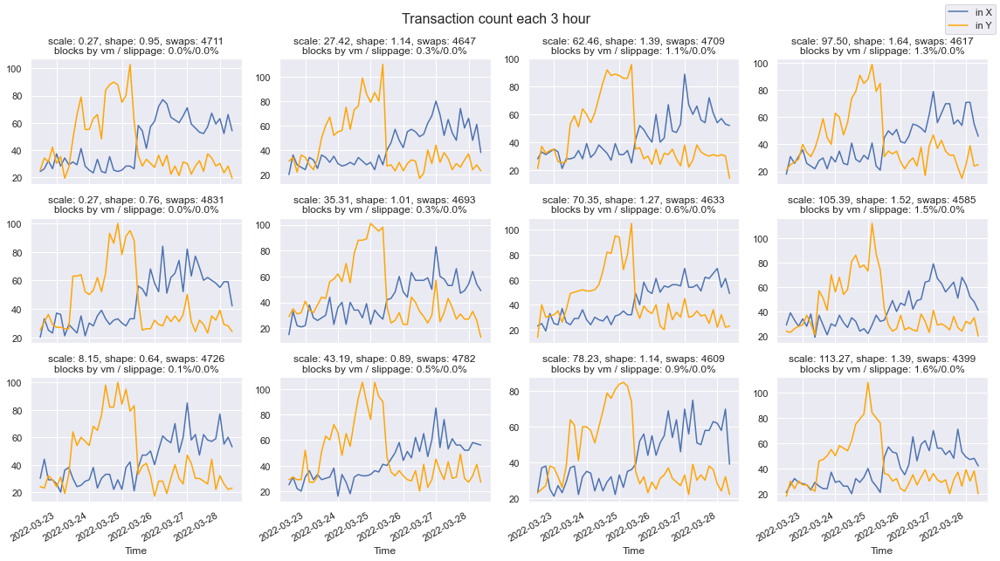

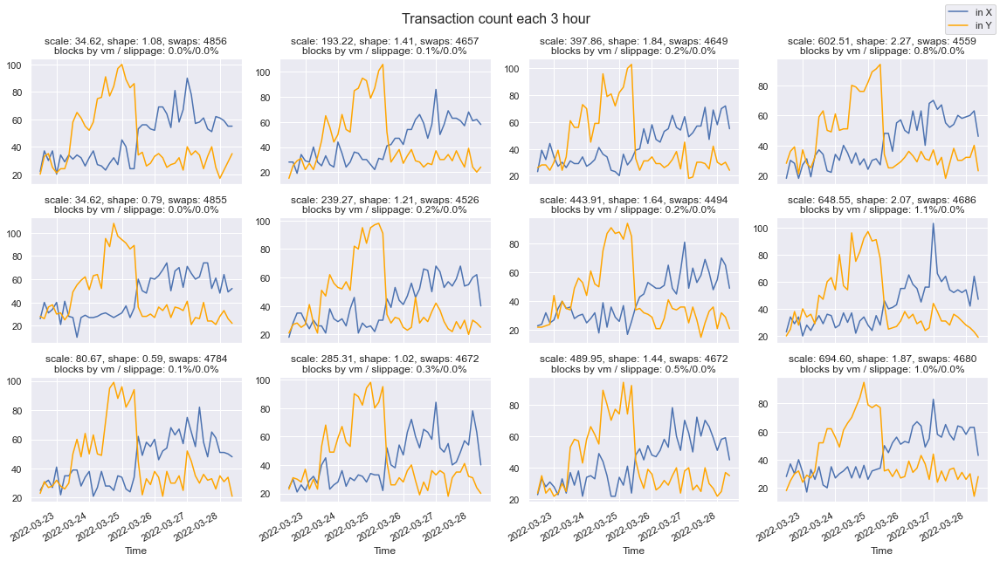

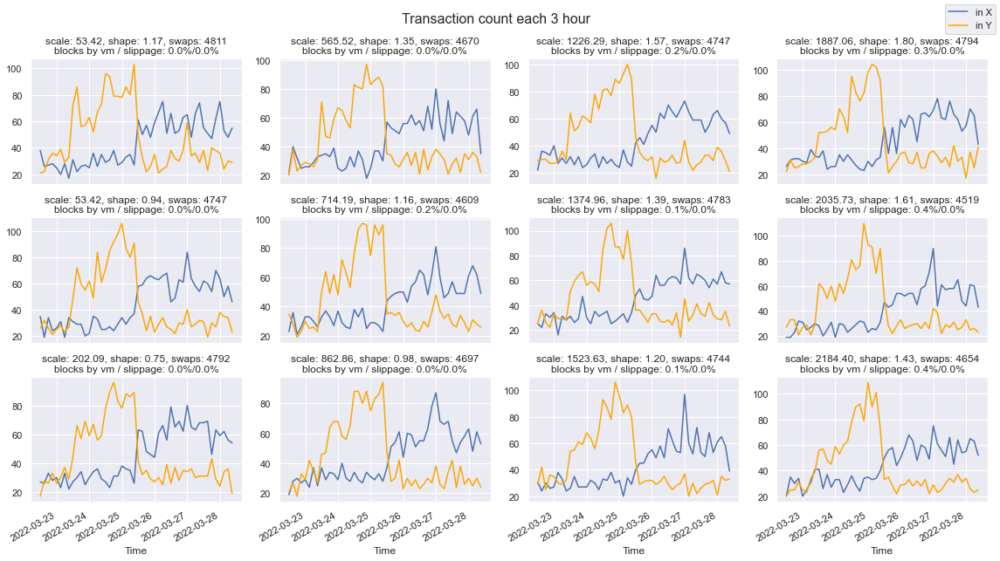

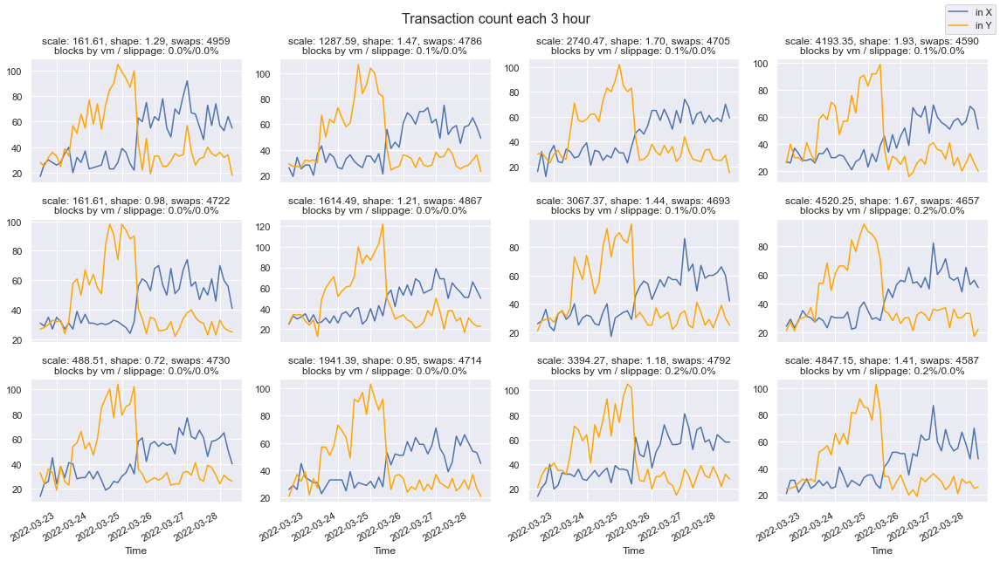

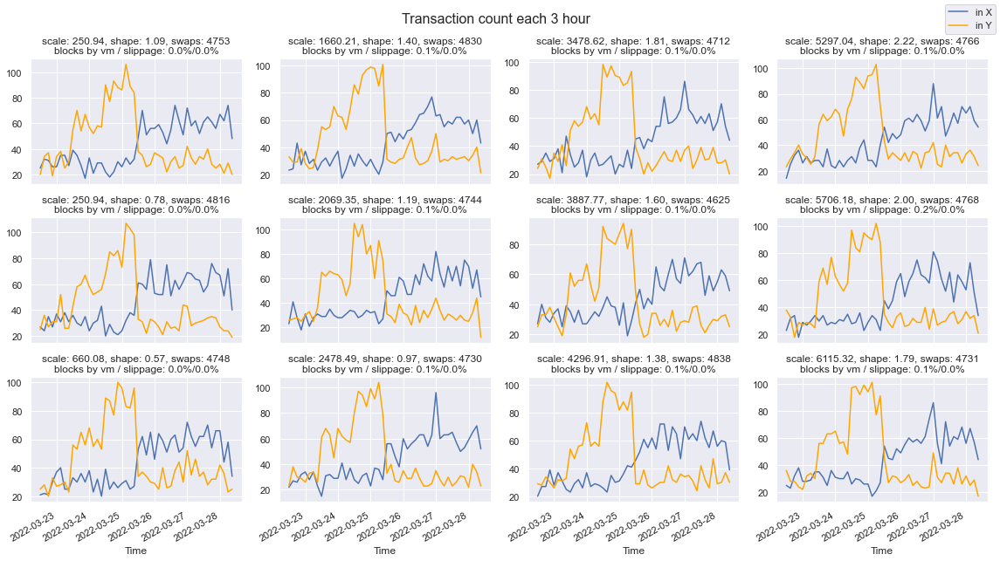

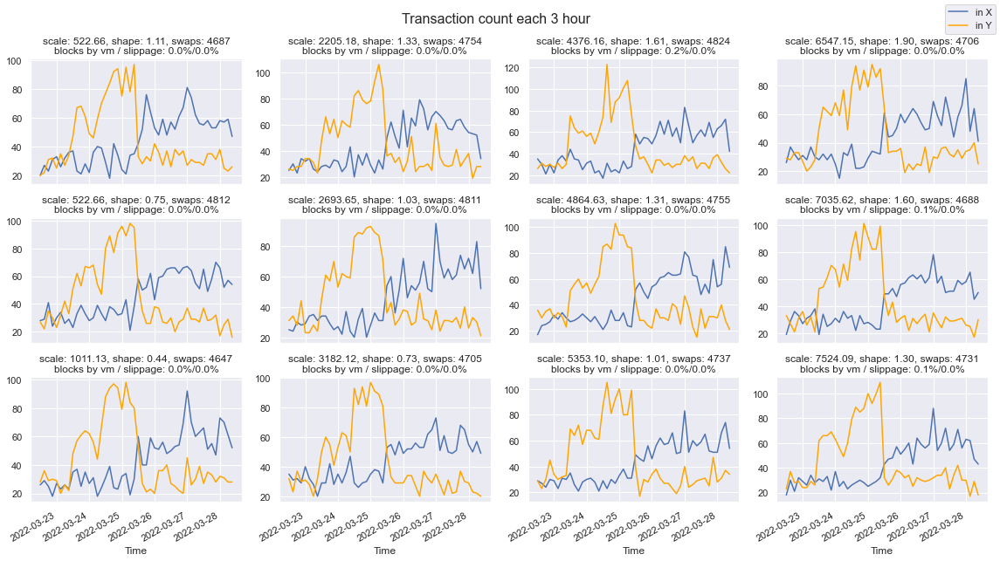

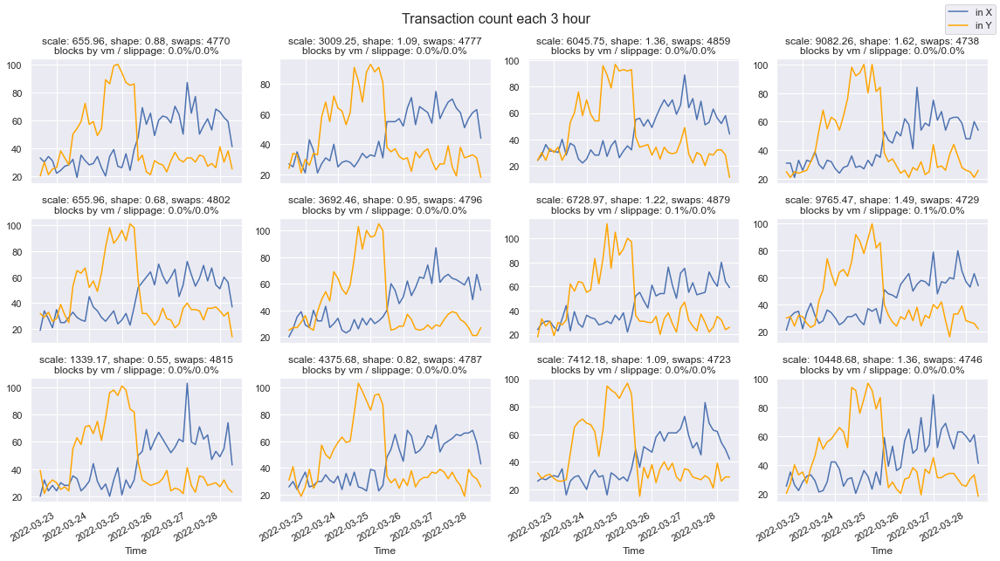

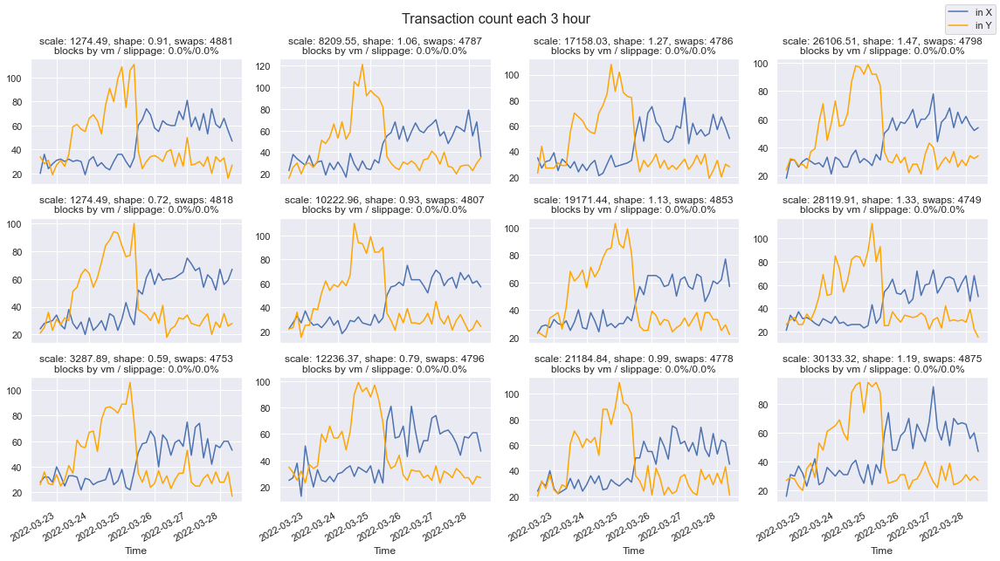

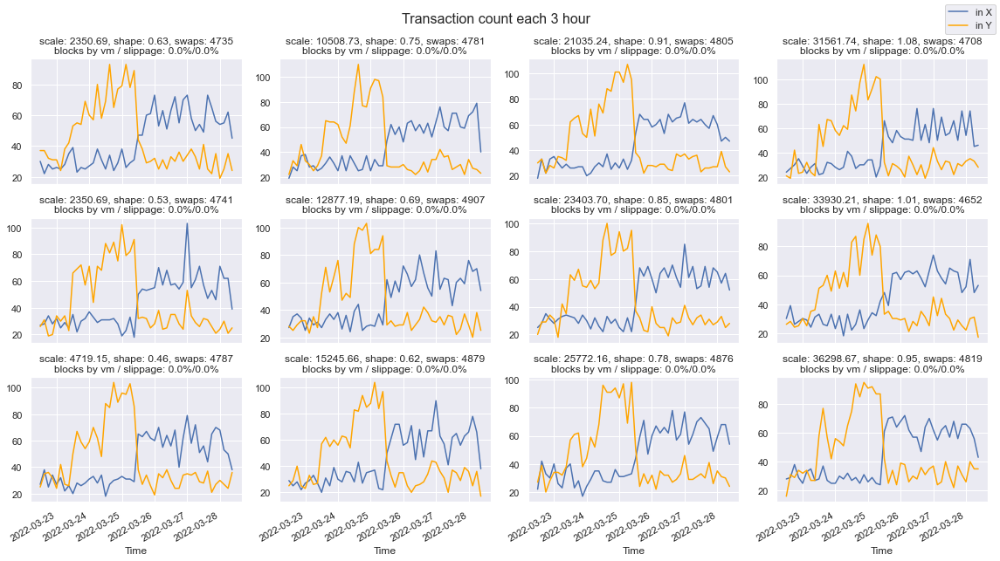

In [64]:
filtered_stats_df.sort_values(by=['initial_reserve_usd', 'scale', 'shape'], inplace=True, ascending=[True, True, False])
reserve_groups = filtered_stats_df.groupby('initial_reserve_usd')


x_upper_limits = [1500, 7000, 15000, 18000, 30000, 50000, 150000, 200000]
j = 0

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    
    for name, curr_reserve_stats_df in reserve_groups:
        N = len(curr_reserve_stats_df)
        COLS = 4
        ROWS = N//COLS + (N%COLS != 0)

        fig, ax = plt.subplots(ROWS, COLS, figsize=(COLS*4, ROWS*3))
        axes = ax.ravel()
        axes = axes.reshape(ROWS, COLS).T.ravel()

        i = 0
        for index, row in curr_reserve_stats_df.iterrows():
            ax = axes[i]

            df0, df1 = simulations[row['sim_index'] - 1], simulations[row['sim_index']]
            plot_frequency(ax, df0, df1,  blocks, count, i == 0, '3h')
            show_title(ax, row, show_legend=(i==0))

            i += 1

        fig.suptitle(f'Transaction count each 3 hour', fontsize=16)
        fig.tight_layout()

In [65]:
def plot_amount_in(ax, swaps0_df, swaps_df, blocks, count, is_first, resample_interval='1h'):
    swaps_x_indexed_df = swaps_df[swaps_df.token_in == 'X'].copy().set_index('transaction_timestamp')
    swaps_y_indexed_df = swaps_df[swaps_df.token_in == 'Y'].copy().set_index('transaction_timestamp')
    
    swaps_x_indexed_df = swaps_x_indexed_df.resample(resample_interval).token_in_amount.sum()
    swaps_y_indexed_df = swaps_y_indexed_df.resample(resample_interval).token_in_amount.sum()

    ax.plot_date(x=swaps_x_indexed_df.index, y=swaps_x_indexed_df, linestyle='solid', marker=None, label='in X', )
    ax.plot_date(x=swaps_y_indexed_df.index, y=swaps_y_indexed_df, linestyle='solid', marker=None, label='in Y', color='orange')

  #  ax.set_title(f'Variation of Price X ({X_NAME}) over time')
    #ax.set_ylim(0, 3)
    ax.set_xlabel('Time')

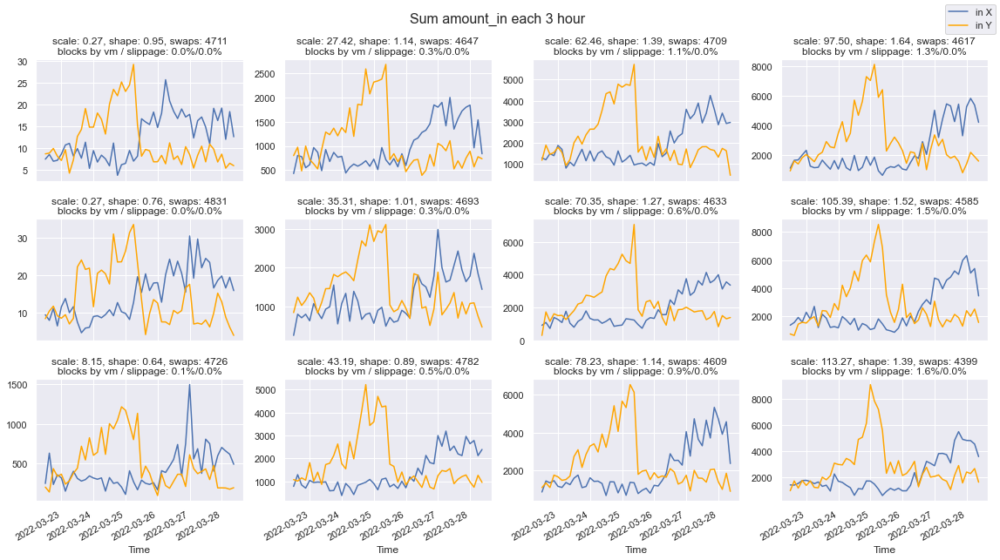

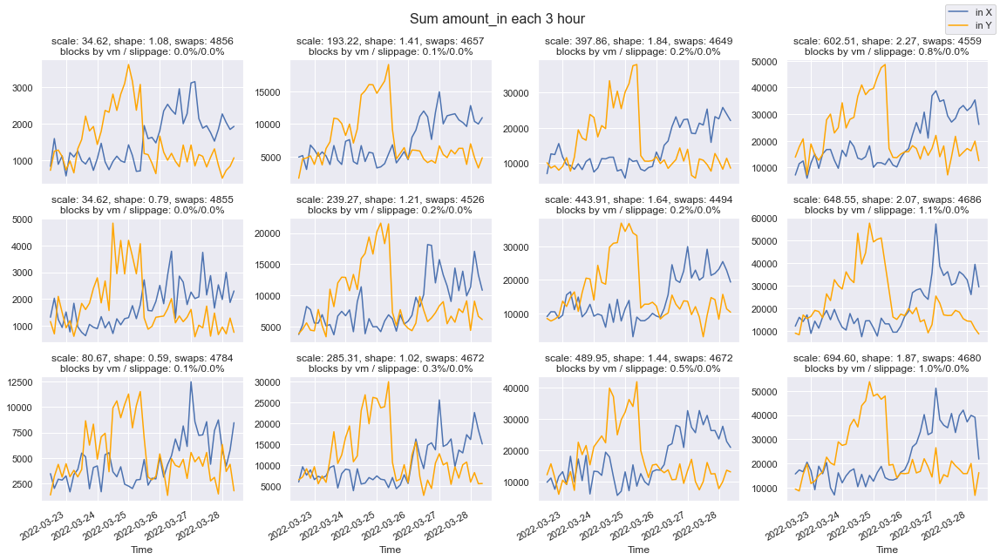

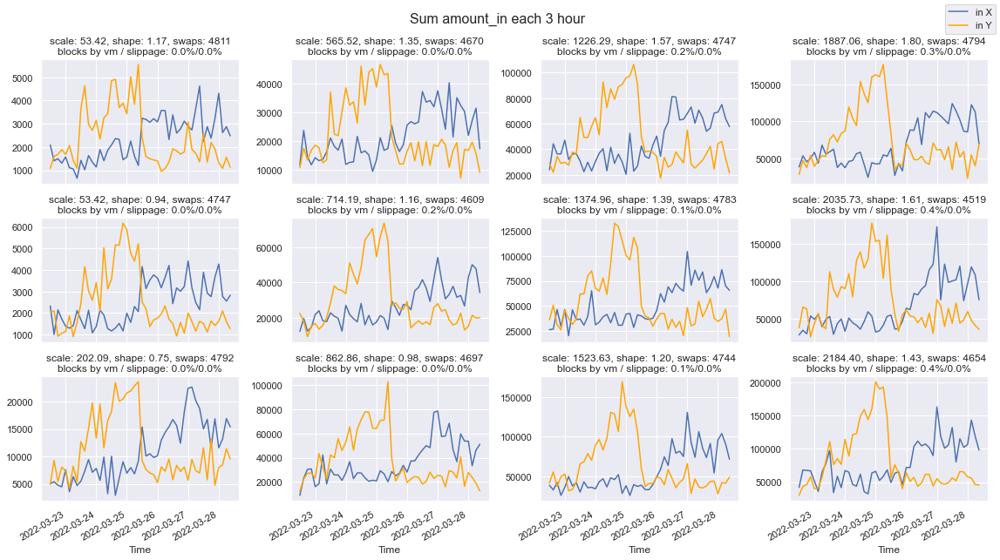

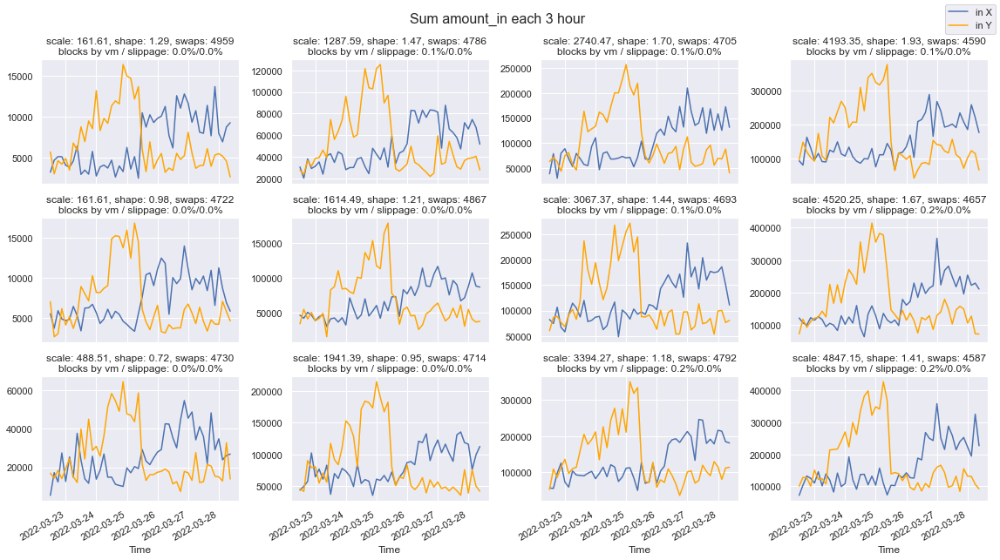

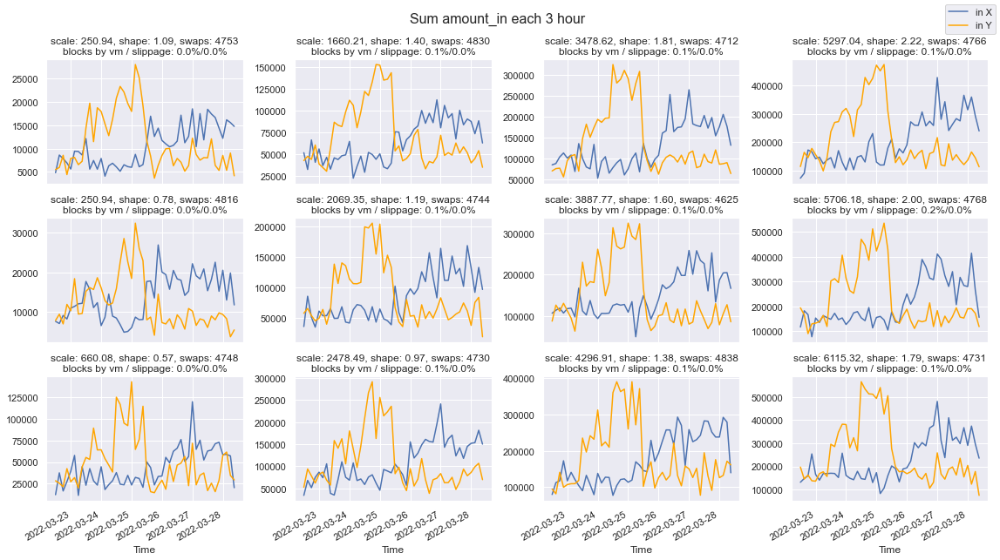

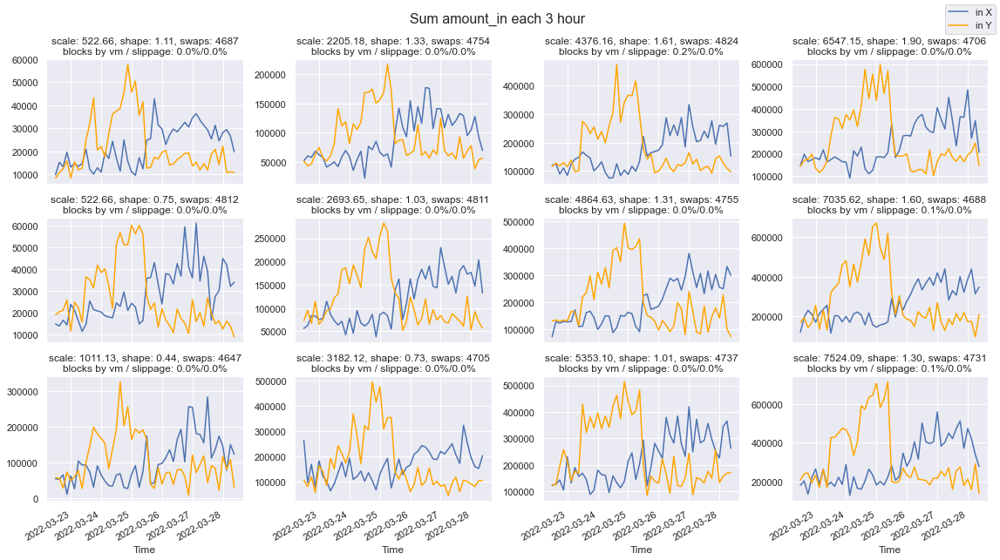

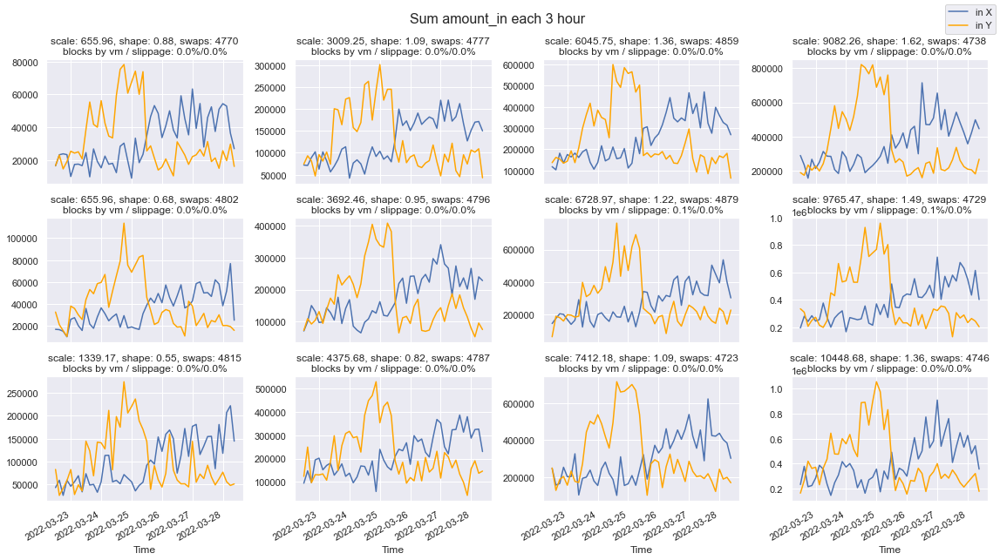

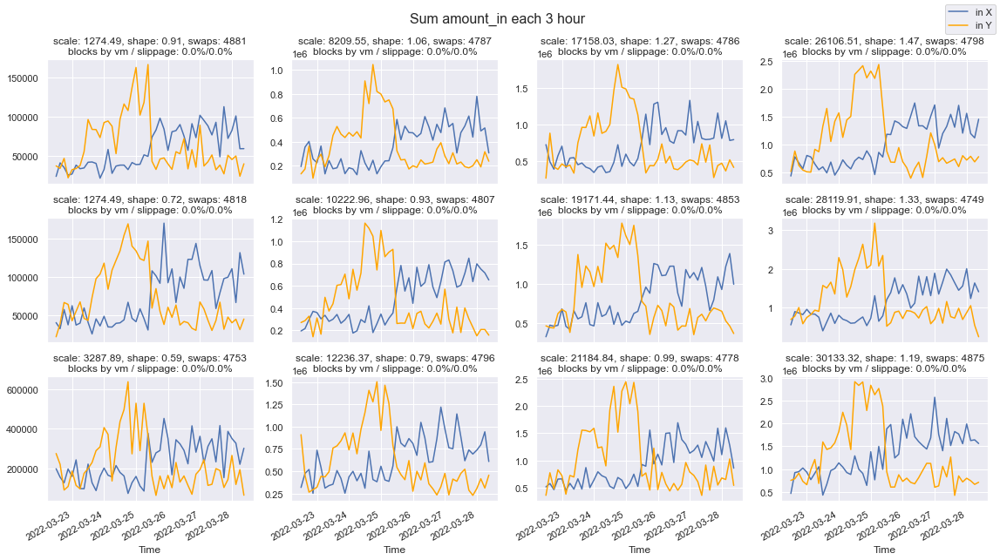

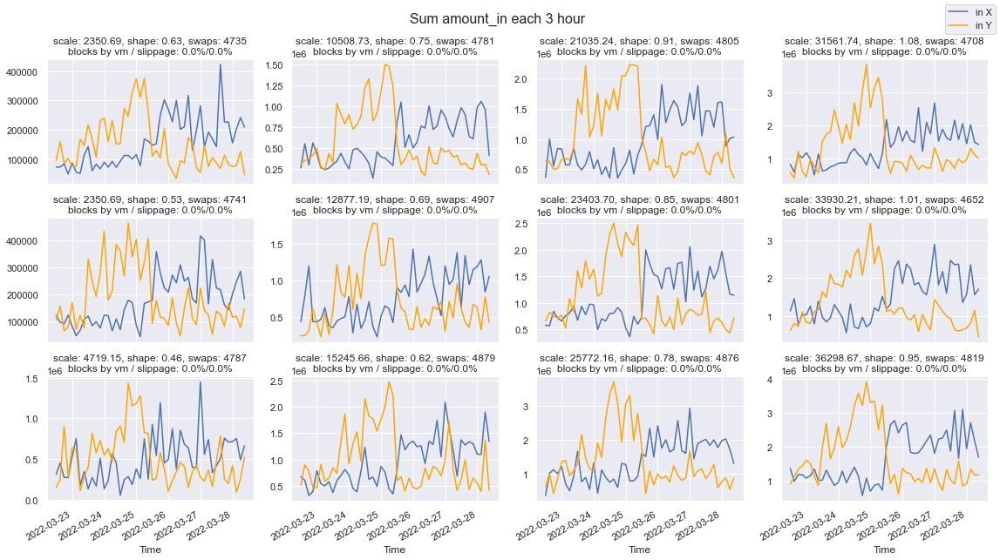

In [66]:
filtered_stats_df.sort_values(by=['initial_reserve_usd', 'scale', 'shape'], inplace=True, ascending=[True, True, False])
reserve_groups = filtered_stats_df.groupby('initial_reserve_usd')

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    
    for name, curr_reserve_stats_df in reserve_groups:
        N = len(curr_reserve_stats_df)
        COLS = 4
        ROWS = N//COLS + (N%COLS != 0)

        fig, ax = plt.subplots(ROWS, COLS, figsize=(COLS*4, ROWS*3))
        axes = ax.ravel()
        axes = axes.reshape(ROWS, COLS).T.ravel()

        i = 0
        for index, row in curr_reserve_stats_df.iterrows():
            ax = axes[i]

            df0, df1 = simulations[row['sim_index'] - 1], simulations[row['sim_index']]
            plot_amount_in(ax, df0, df1,  blocks, count, i == 0, '3h')
            show_title(ax, row, show_legend=(i==0))

            i += 1

        fig.suptitle(f'Sum amount_in each 3 hour', fontsize=16)
        fig.tight_layout()

In [67]:
def plot_blocked_datetime(ax, swaps0_df, swaps_df, blocks, count, is_first, resample_interval='1h'):
    success_x_df = swaps_df[(swaps_df.status == 'SUCCESS') & ((swaps_df.token_in == 'X'))]
    success_y_df = swaps_df[(swaps_df.status == 'SUCCESS') & ((swaps_df.token_in == 'Y'))]
        
    blocked_x_df = swaps_df[(swaps_df.status != 'SUCCESS') & ((swaps_df.token_in == 'X'))]
    blocked_y_df = swaps_df[(swaps_df.status != 'SUCCESS') & ((swaps_df.token_in == 'Y'))]
    
    blocked_x_df.index = blocked_x_df.transaction_timestamp
    blocked_y_df.index = blocked_y_df.transaction_timestamp
    success_x_df.index = success_x_df.transaction_timestamp
    success_y_df.index = success_y_df.transaction_timestamp
    
    blocked_x_df.loc[success_y_df.index.max()] = None
    blocked_y_df.loc[success_y_df.index.max()] = None
    blocked_x_df.loc[success_y_df.index.min()] = None
    blocked_y_df.loc[success_y_df.index.min()] = None
    
    success_x_s = success_x_df.resample(resample_interval).size()
    success_y_s = success_y_df.resample(resample_interval).size()

    blocked_x_s = blocked_x_df.resample(resample_interval).size()
    blocked_y_s = blocked_y_df.resample(resample_interval).size()
    
    blocked_x_s.iloc[-1] -=1
    blocked_y_s.iloc[-1] -=1

    blocked_x_s.iloc[0] -=1
    blocked_y_s.iloc[0] -=1
    
    ratio_blocked_x = blocked_x_s / (success_x_s + blocked_x_s)
    ratio_blocked_y = blocked_y_s / (success_y_s + blocked_y_s)
    ratio_blocked_x[(success_x_s + blocked_x_s) == 0] = 0
    ratio_blocked_y[(success_y_s + blocked_y_s) == 0] = 0

    ax.plot_date(x=ratio_blocked_x.index, y=ratio_blocked_x, linestyle='solid', marker=None, label='in X', )
    ax.plot_date(x=ratio_blocked_y.index, y=ratio_blocked_y, linestyle='solid', marker=None, label='in Y', color='orange')

  #  ax.set_title(f'Variation of Price X ({X_NAME}) over time')
    #ax.set_ylim(0, 3)
    ax.set_xlabel('Time')    

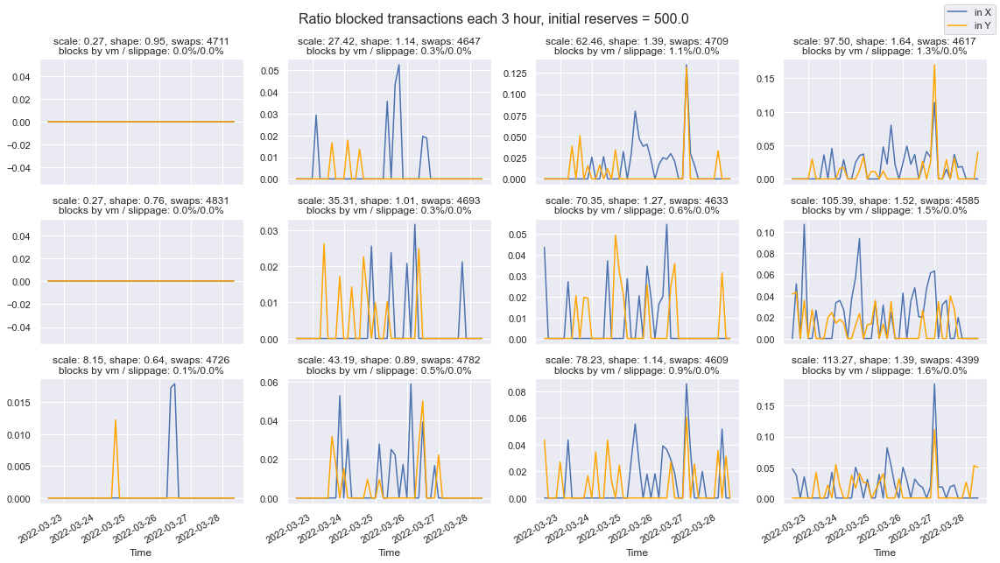

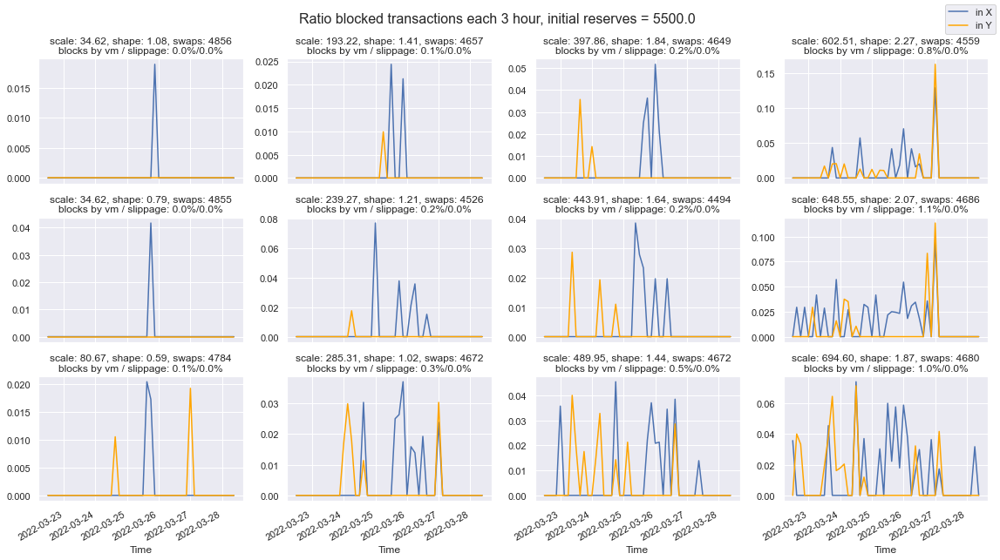

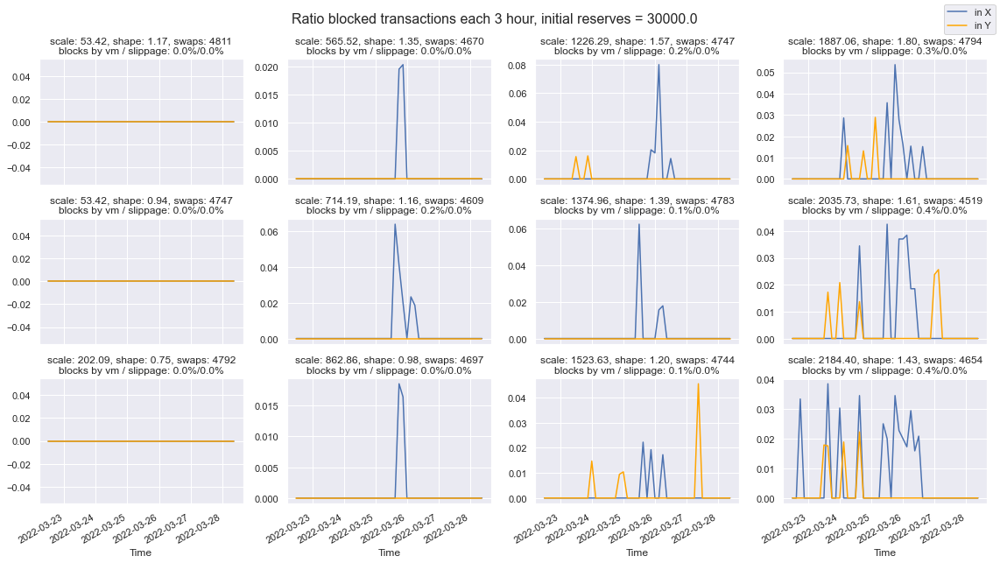

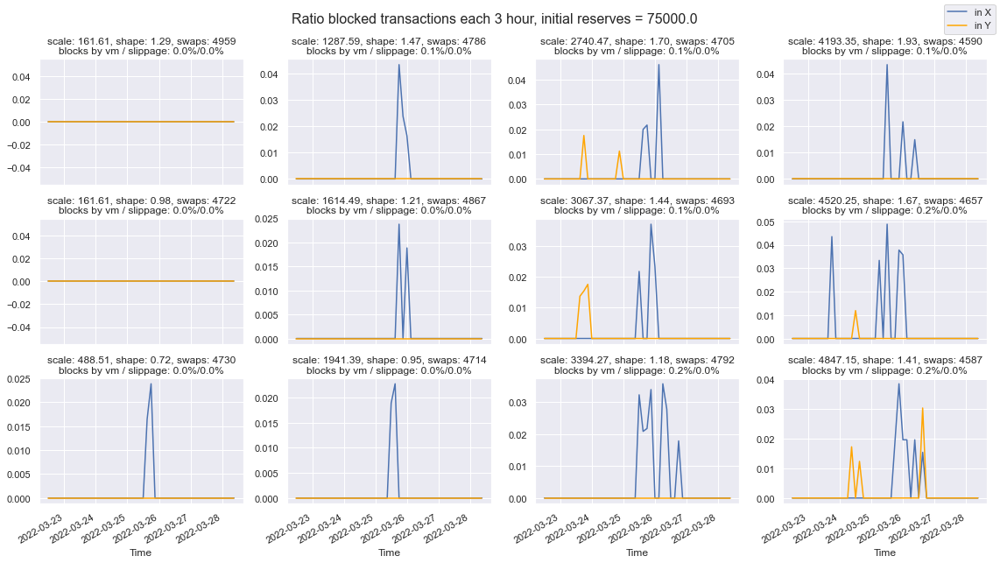

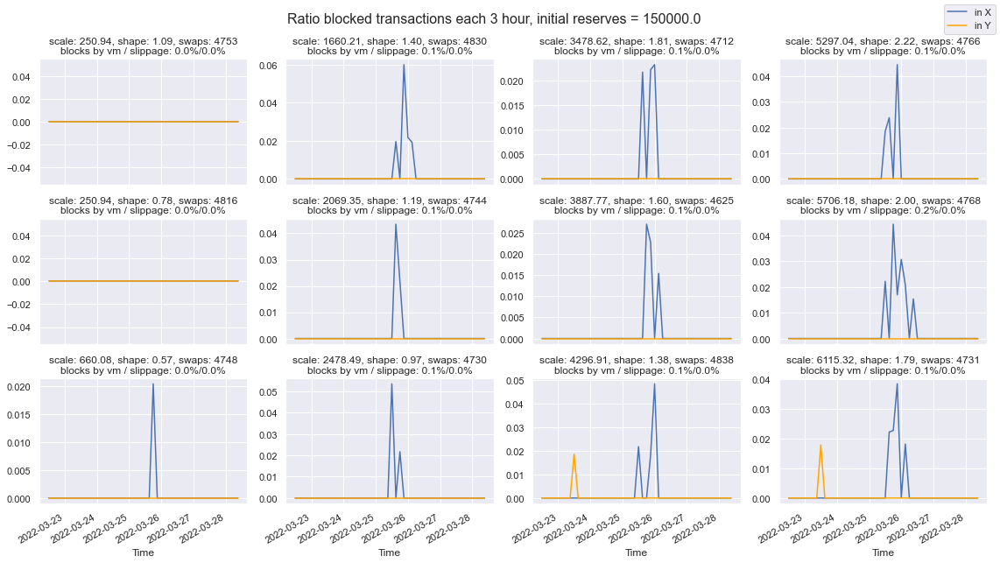

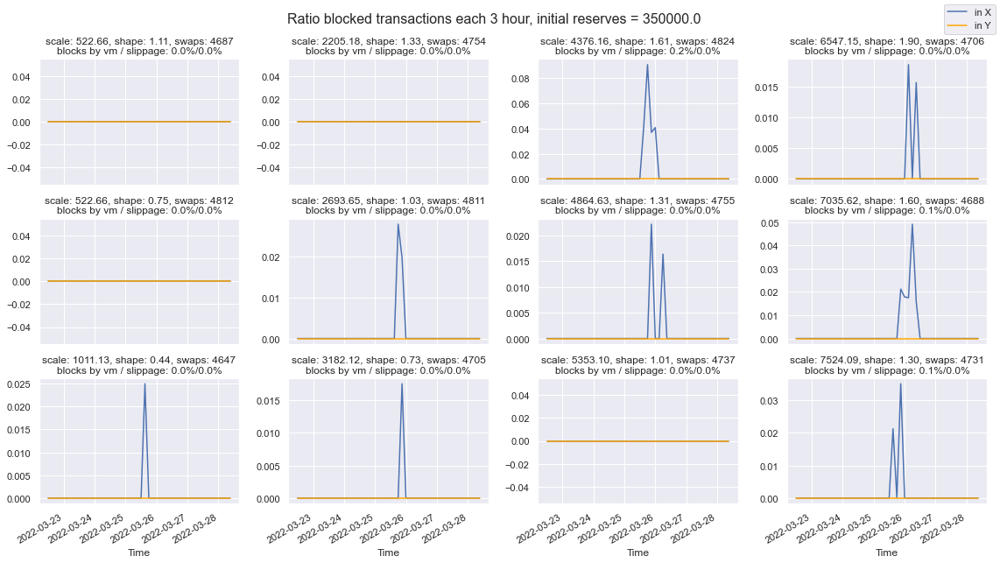

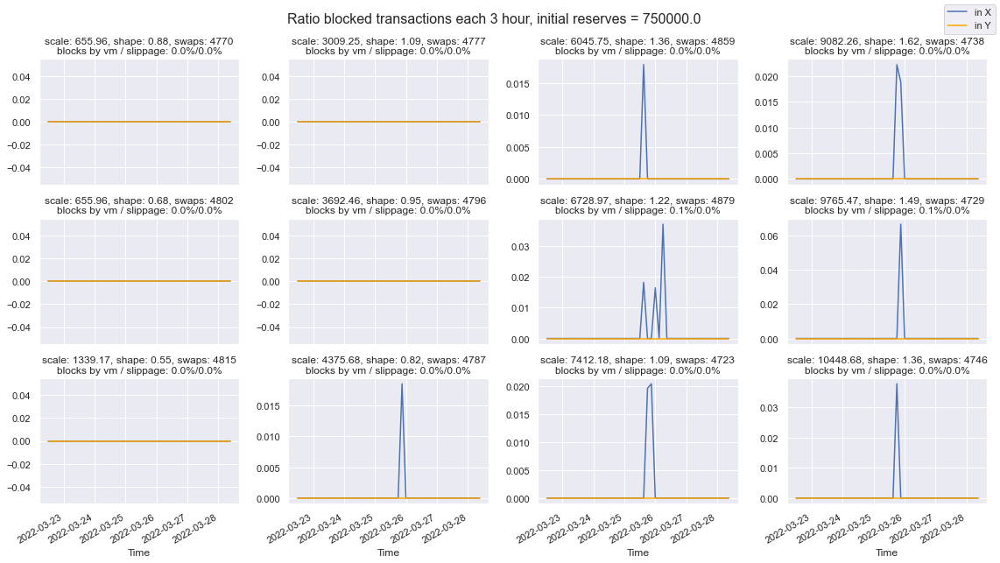

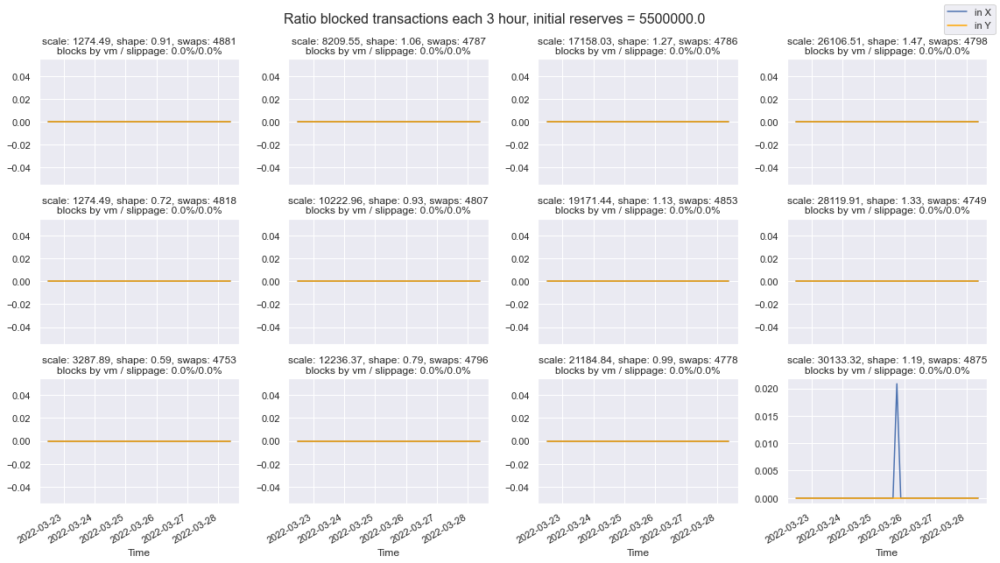

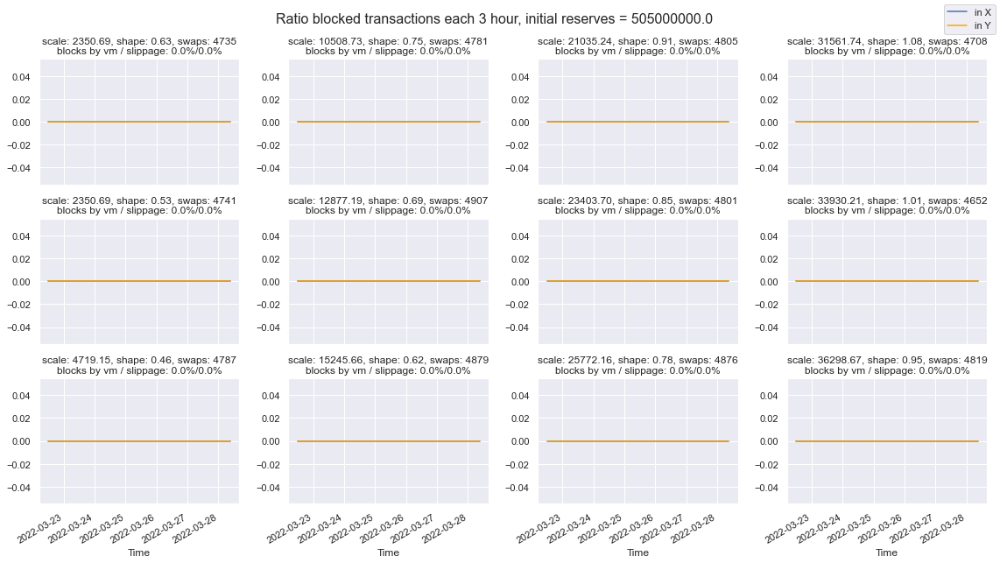

In [68]:
filtered_stats_df.sort_values(by=['initial_reserve_usd', 'scale', 'shape'], inplace=True, ascending=[True, True, False])
reserve_groups = filtered_stats_df.groupby('initial_reserve_usd')

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    
    for name, curr_reserve_stats_df in reserve_groups:
        N = len(curr_reserve_stats_df)
        COLS = 4
        ROWS = N//COLS + (N%COLS != 0)

        fig, ax = plt.subplots(ROWS, COLS, figsize=(COLS*4, ROWS*3))
        axes = ax.ravel()
        axes = axes.reshape(ROWS, COLS).T.ravel()

        i = 0
        for index, row in curr_reserve_stats_df.iterrows():
            ax = axes[i]

            df0, df1 = simulations[row['sim_index'] - 1], simulations[row['sim_index']]
            plot_blocked_datetime(ax, df0, df1,  blocks, count, i == 0, '3h')
            show_title(ax, row, i==0)

            i += 1

        fig.suptitle(f'Ratio blocked transactions each 3 hour, initial reserves = {name}', fontsize=16)
        fig.tight_layout()


In [69]:
import math

def get_success_ratio_df(swaps1_df, x_upper_limit, bins=10):
    bandwidth = x_upper_limit // bins
    MAX = x_upper_limit
    #swaps1_df[swaps1_df.token_in == 'Y'].token_in_amount.max() # HARDCODED Y_NAME
    success_ratio_df = pd.DataFrame(columns=['lower', 'upper', 'ratio', 'occur'])

    for index, i in enumerate(range(0, math.ceil(MAX - bandwidth + 1), int(bandwidth))):
        a, b = i, i + bandwidth

        range_swaps_y_df = swaps1_df[(swaps1_df.token_in == 'Y') & (swaps1_df.token_in_amount >= a) &
                                      (swaps1_df.token_in_amount <= b)]

        success_cnt = range_swaps_y_df[range_swaps_y_df.status == 'SUCCESS'].shape[0]
        blocked_vm_cnt = range_swaps_y_df[range_swaps_y_df.status == 'BLOCKED_BY_VOLATILITY_MITIGATION'].shape[0]
        total_cnt = range_swaps_y_df.shape[0]
        
        if total_cnt != 0:#???
            success_ratio = success_cnt / total_cnt

            success_ratio_df.loc[index] = [a, b, success_ratio, total_cnt]
    
    return success_ratio_df

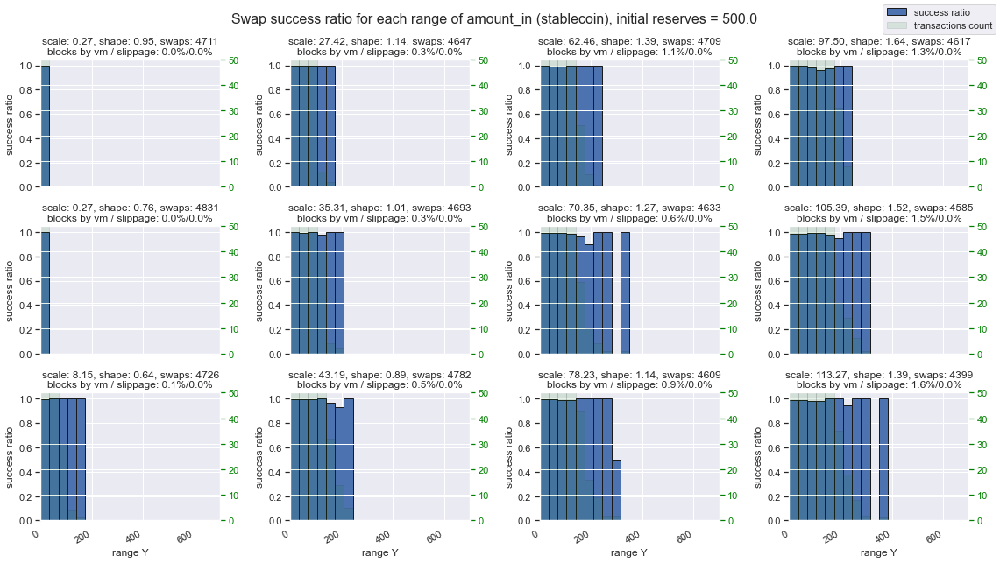

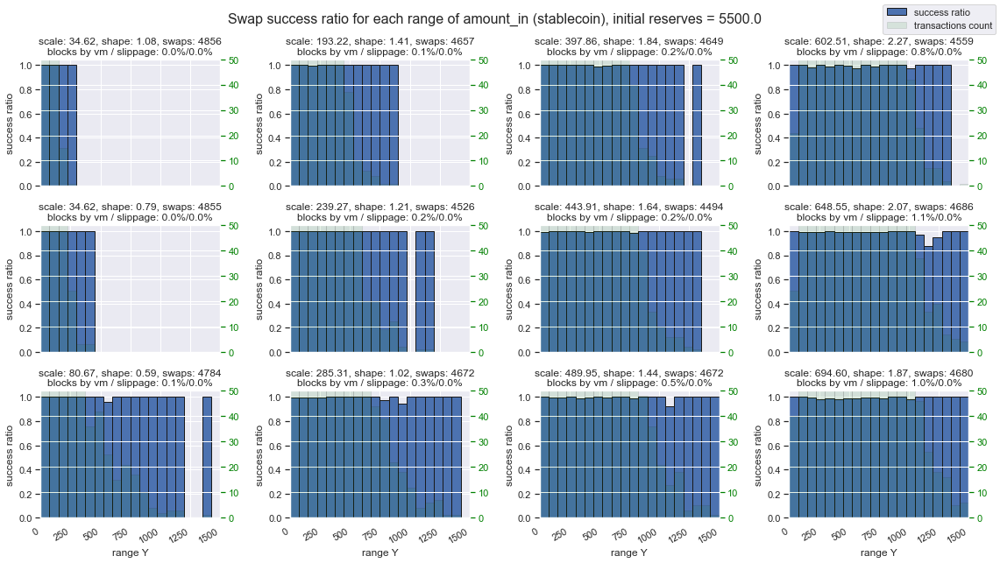

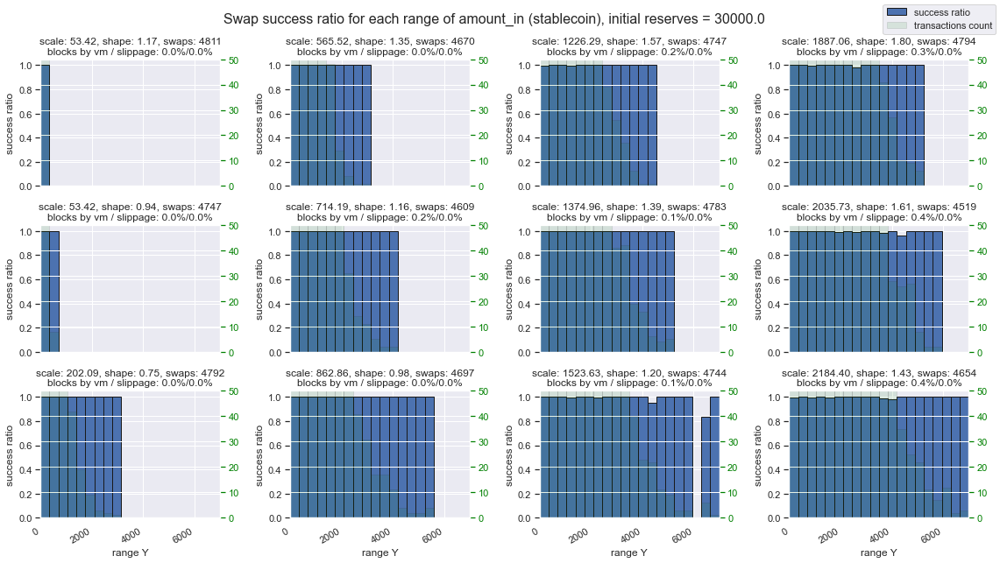

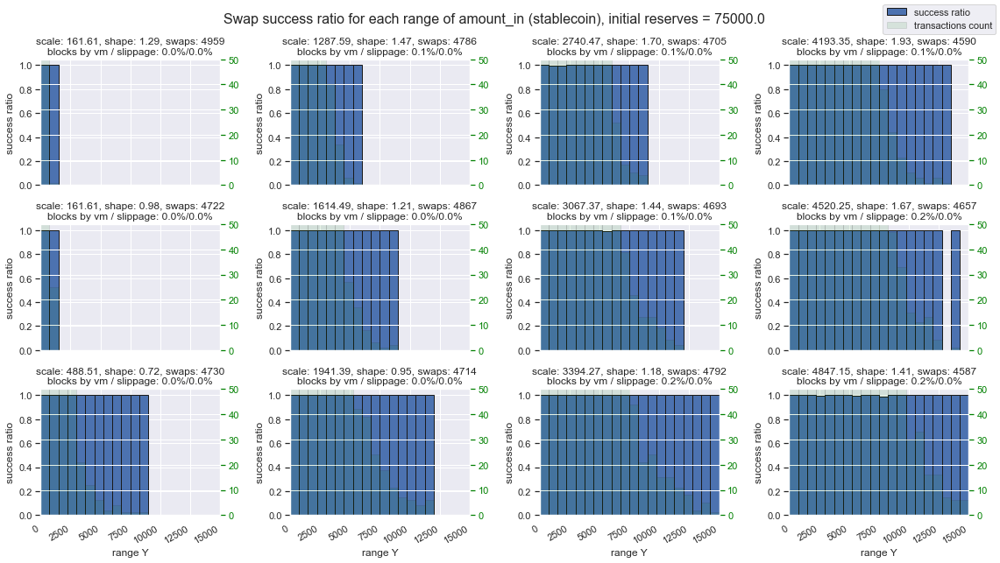

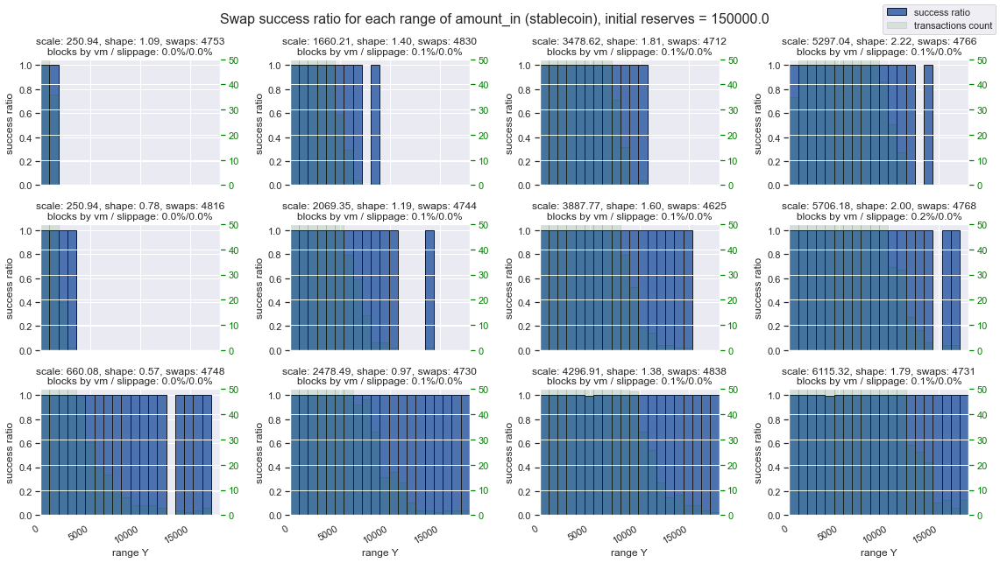

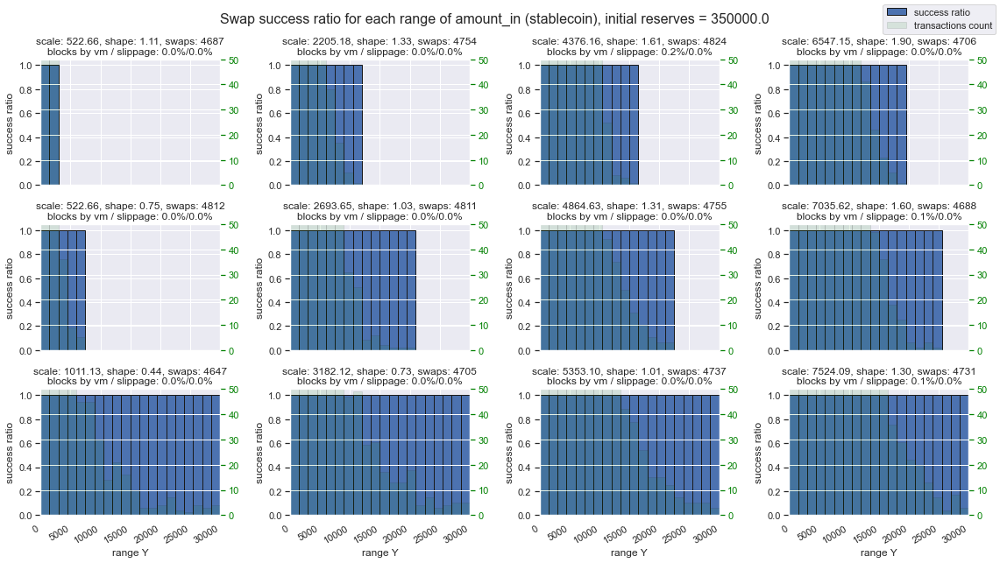

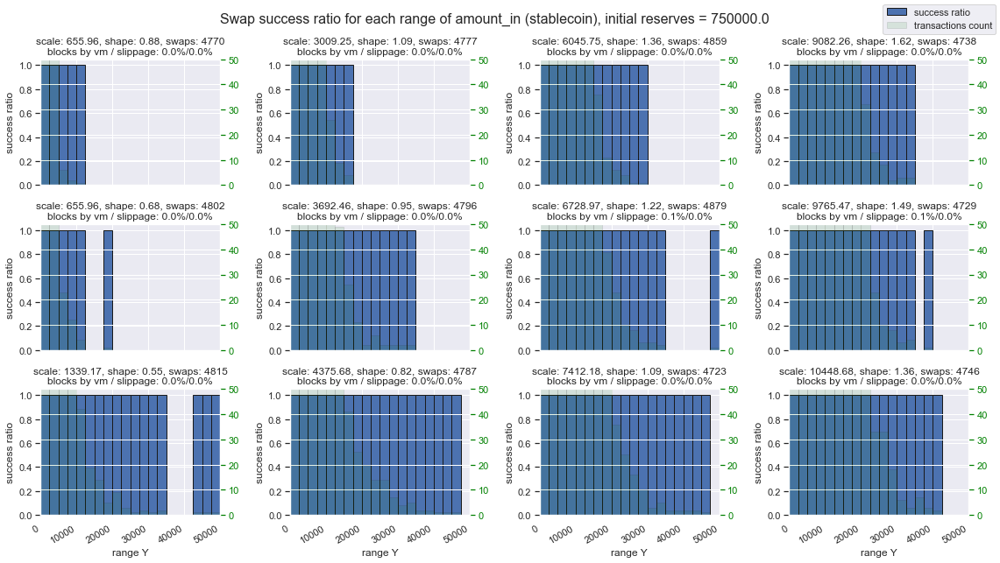

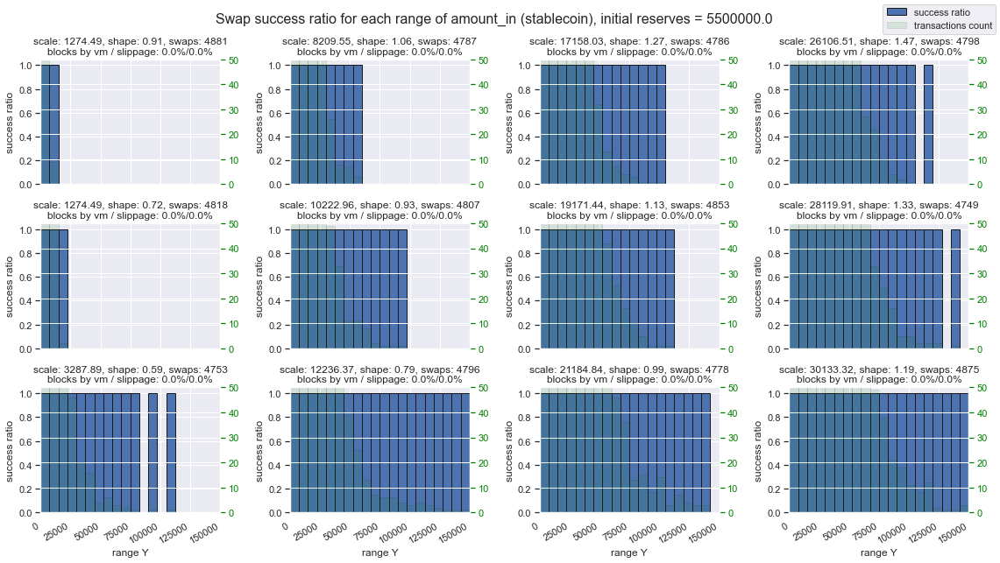

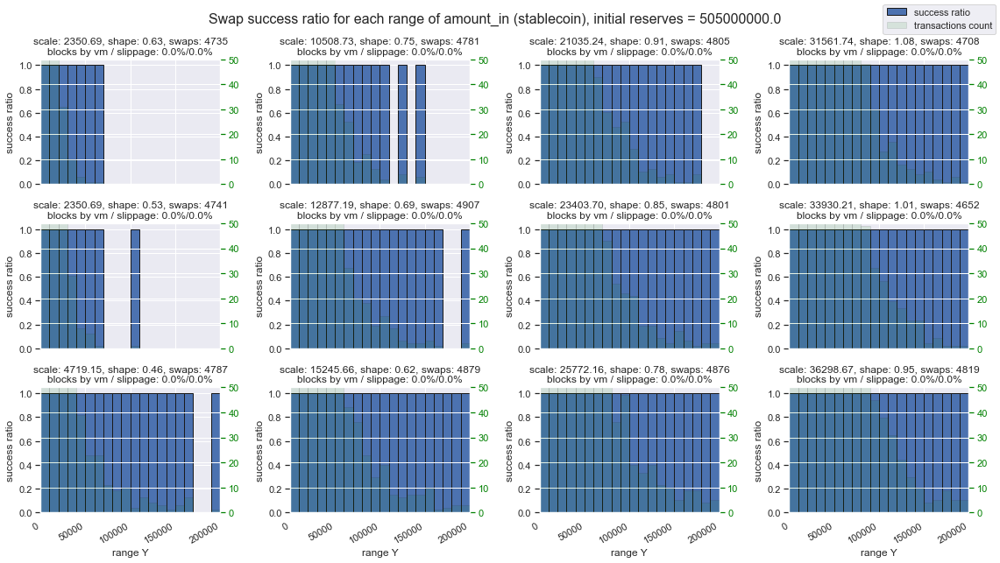

In [70]:
filtered_stats_df.sort_values(by=['initial_reserve_usd', 'scale', 'shape'], inplace=True, ascending=[True, True, False])
reserve_groups = filtered_stats_df.groupby('initial_reserve_usd')


x_upper_limits = [700, 1500, 7000, 15000, 18000, 30000, 50000, 150000, 200000, 250000]
j = 0

for name, curr_reserve_stats_df in reserve_groups:
    N = len(curr_reserve_stats_df)
    COLS = 4
    ROWS = N//COLS + (N%COLS != 0)

    fig, ax = plt.subplots(ROWS, COLS, figsize=(COLS*4, ROWS*3))
    axes = ax.ravel()
    axes = axes.reshape(ROWS, COLS).T.ravel()

    i = 0
    for index, row in curr_reserve_stats_df.iterrows():
        ax = axes[i]

        scale, shape, initial_reserve_usd, blocks, count = row['scale'], row['shape'], row['initial_reserve_usd'], row['blocked_transactions'], row['count']

        df = simulations[row['sim_index']]

        success_ratio_df = get_success_ratio_df(df, x_upper_limits[j], 20)
        #print(success_ratio_df)


        ax2 = ax.twinx()
        ax2.bar(success_ratio_df.lower, success_ratio_df.occur, width=success_ratio_df.upper-success_ratio_df.lower, ec="k", align="edge", label='transactions count', color='green', alpha=0.1)
        ax2.set_ylim(0, 50)
        ax2.tick_params(axis='y', colors='green')
        #ax.tick_params(axis='y', colors='blue')

        ax.set_xlabel('range Y')
        ax.set_ylabel('success ratio')

        ax.set_xlim(0, x_upper_limits[j])
        ax.bar(success_ratio_df.lower, success_ratio_df.ratio, width=success_ratio_df.upper-success_ratio_df.lower, ec="k", align="edge", label='success ratio')
        show_title(ax, row, i==0)
        
        i += 1

    
    fig.suptitle(f'Swap success ratio for each range of amount_in (stablecoin), initial reserves = {name}', fontsize=16)
    fig.tight_layout()
    
    j += 1


In [71]:
def slice_factor_curve(ax, swaps1_df):
    sns.scatterplot(data=swaps1_df[swaps1_df.mitigator_check_status == 'CHECKED'], x='slice_factor', y='out_amount_diff', hue='status', hue_order=['SUCCESS', 'BLOCKED_BY_VOLATILITY_MITIGATION',], ax=ax)

    slice_factor = np.arange(0, 100)
    slice_factor_curve = slice_factor * np.sqrt(slice_factor).astype(int)
    slice_factor_curve[slice_factor_curve > 98] = 98
    out_amount_diff = (100 - slice_factor_curve)
    g = sns.lineplot(x=slice_factor, y=out_amount_diff, color='red', label='out_amount_diff_limit', ax=ax)
    g.legend_.remove()


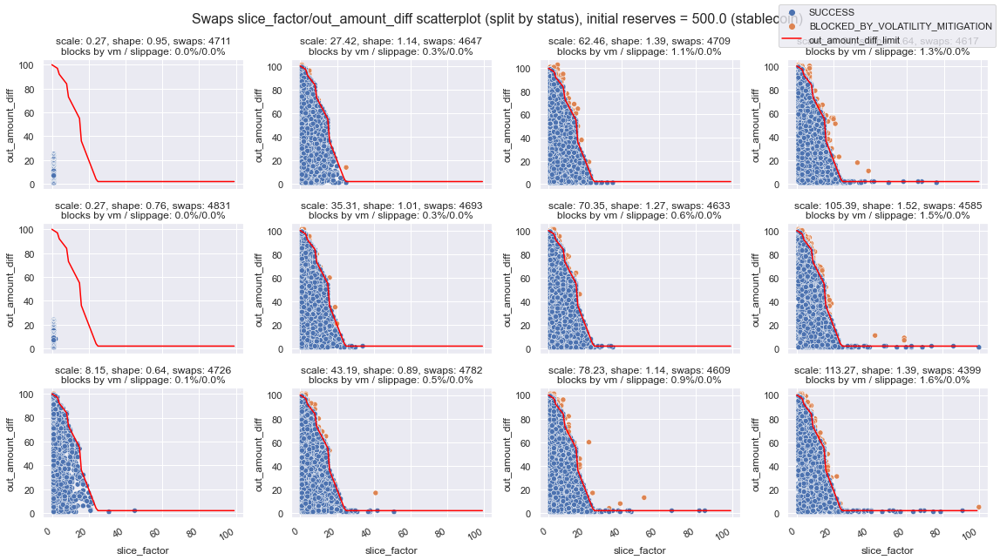

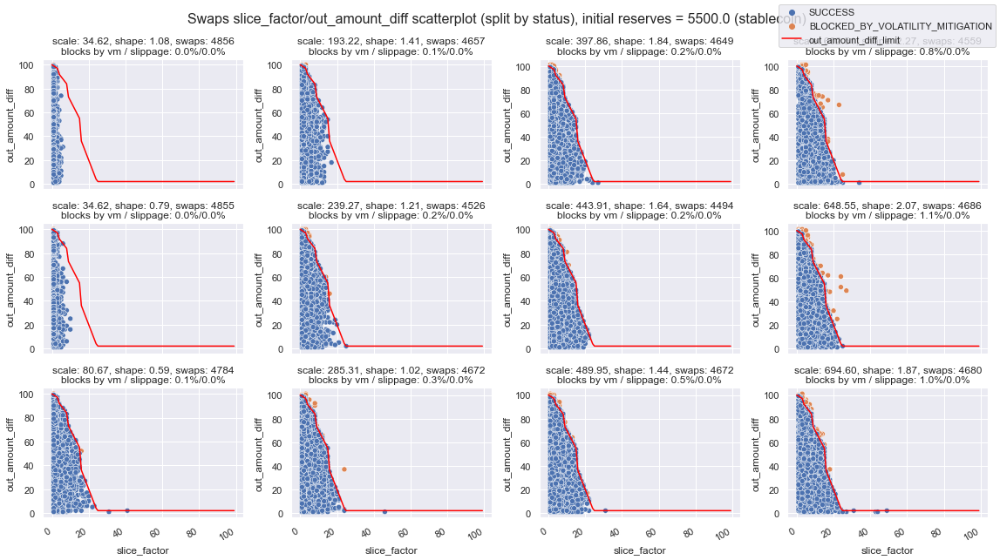

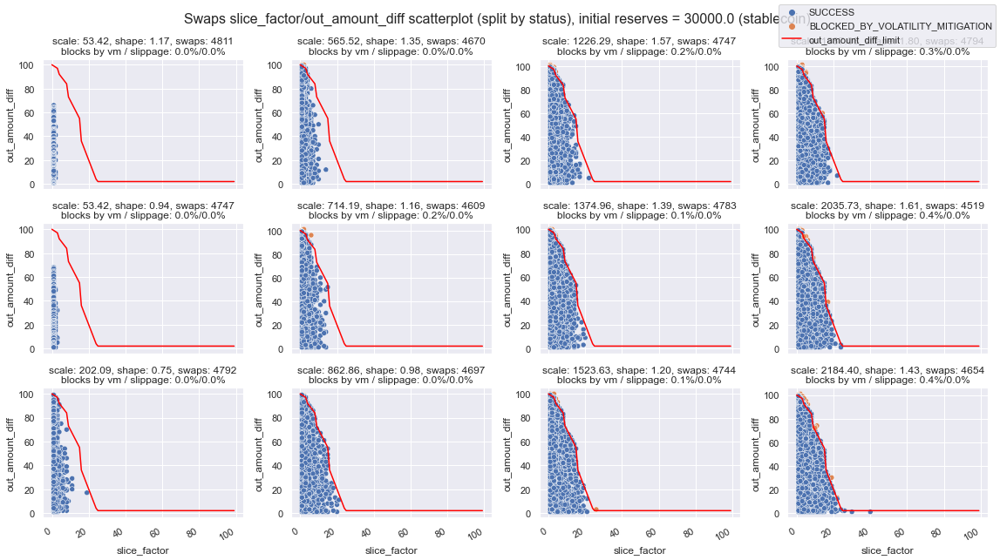

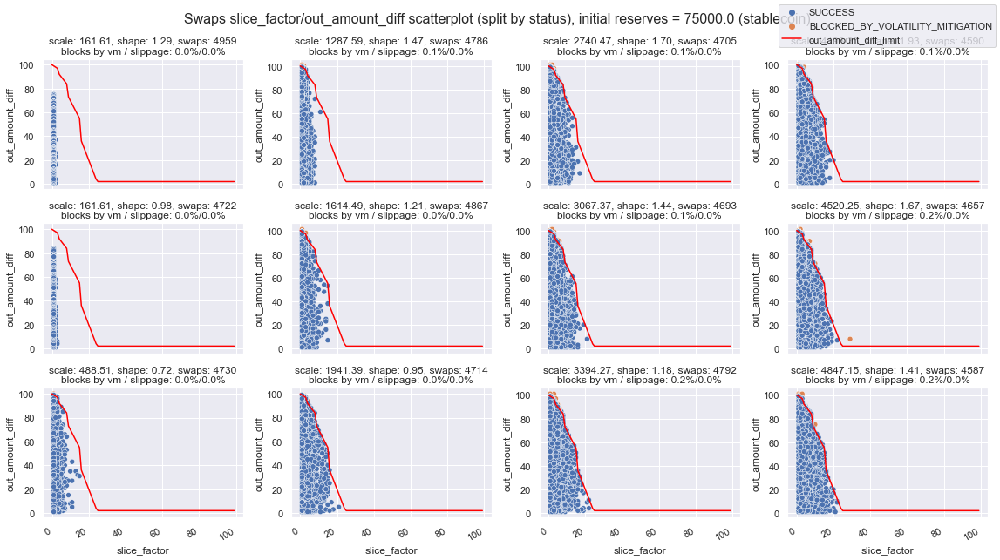

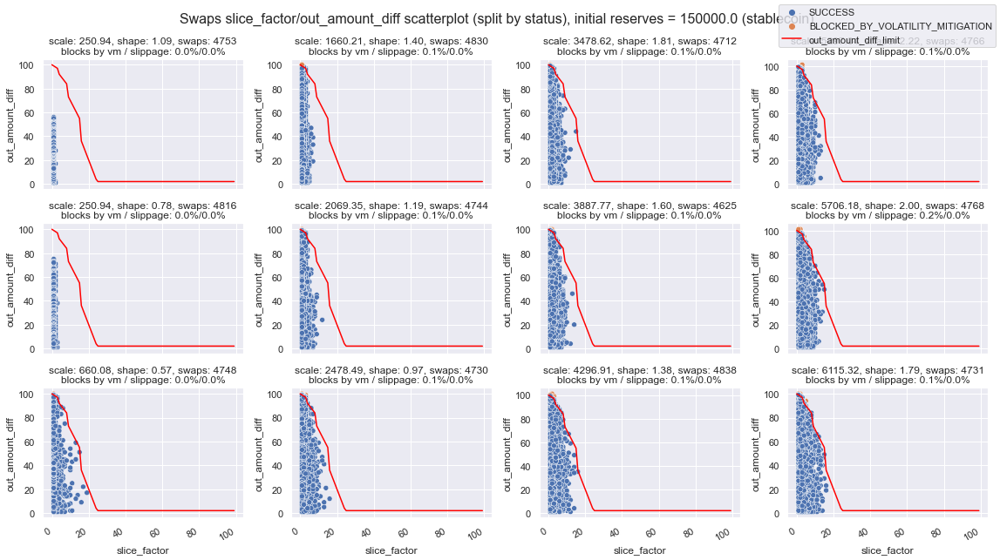

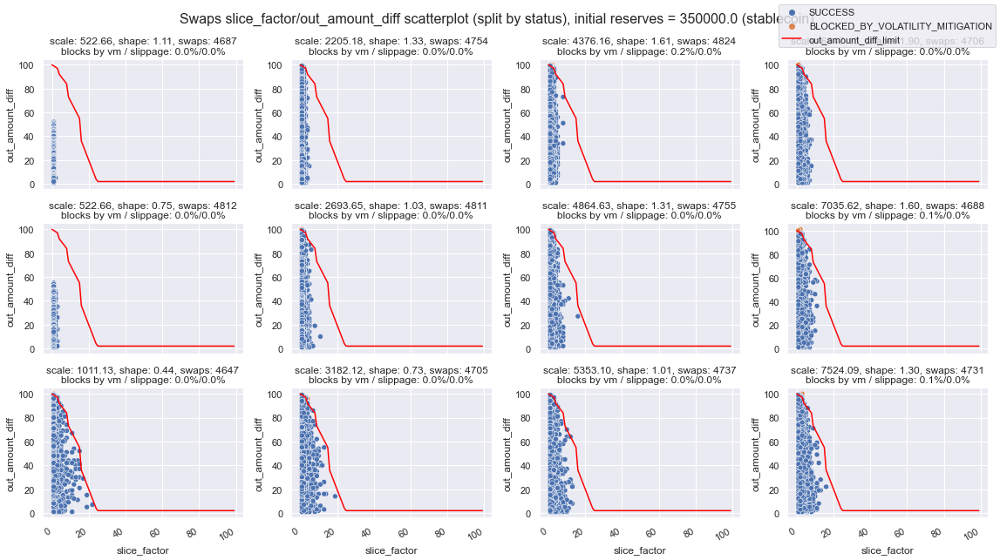

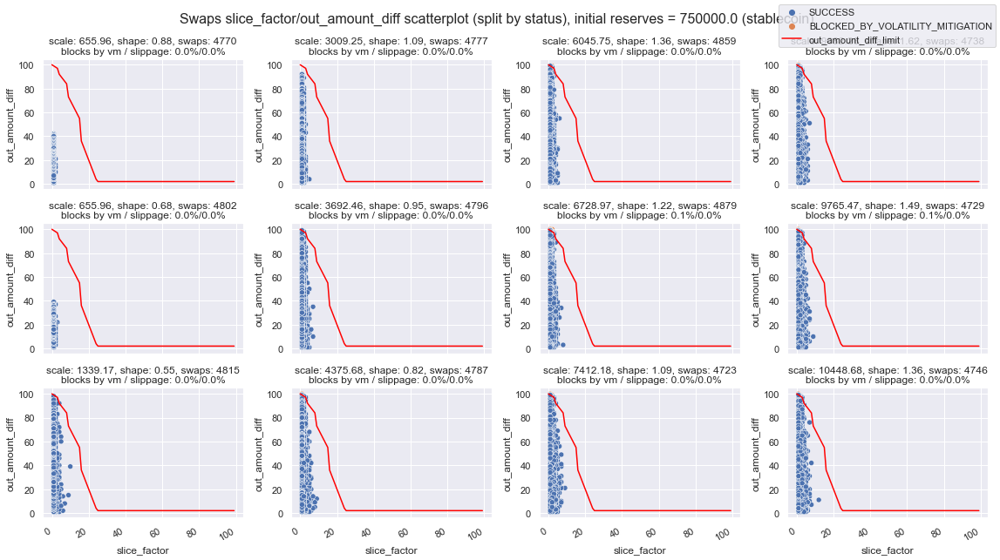

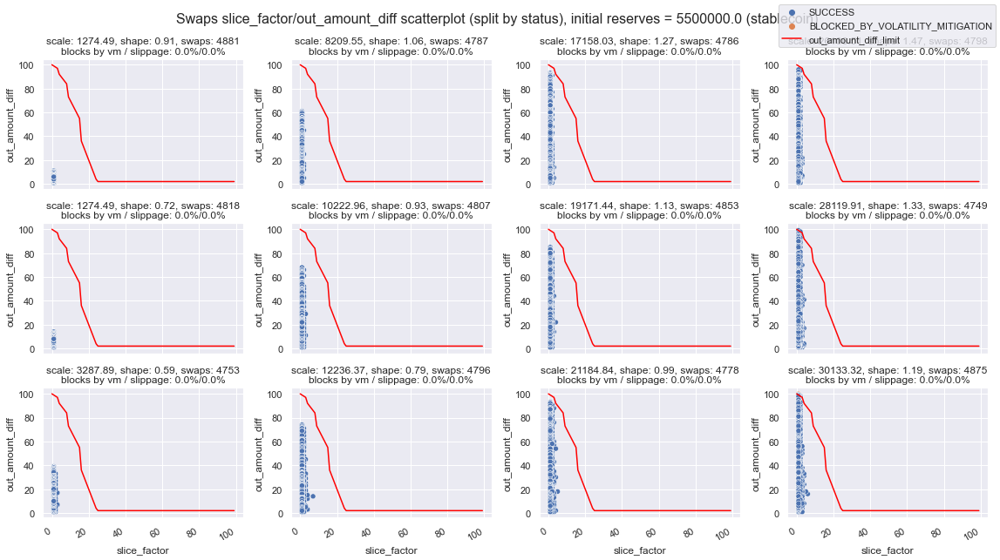

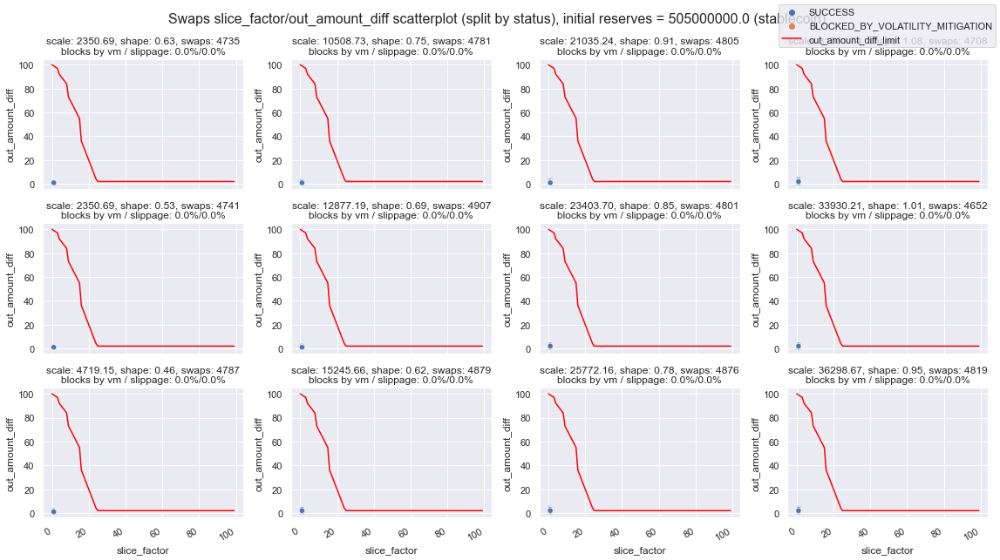

In [72]:
import matplotlib.pyplot as plt

filtered_stats_df.sort_values(by=['initial_reserve_usd', 'scale', 'shape'], inplace=True, ascending=[True, True, False])
reserve_groups = filtered_stats_df.groupby('initial_reserve_usd')
j = 0

for name, curr_reserve_stats_df in reserve_groups:
    N = len(curr_reserve_stats_df)
    COLS = 4
    ROWS = N//COLS + (N%COLS != 0)

    fig, ax = plt.subplots(ROWS, COLS, figsize=(COLS*4, ROWS*3))
    axes = ax.ravel()
    axes = axes.reshape(ROWS, COLS).T.ravel()

    i = 0
    for index, row in curr_reserve_stats_df.iterrows():
        ax = axes[i]
        scale, shape, initial_reserves_usd = row['scale'], row['shape'], row['initial_reserve_usd']
        blocks, blocks_vm, blocks_slippage, count = row['blocked_transactions'], row['blocked_by_volatility_mitigator'], row['blocked_exceeded_slippage'], row['count']
    
        df = simulations[row['sim_index']]
        slice_factor_curve(ax, df)
        show_title(ax, row, i==0)

        i += 1



    fig.suptitle(f'Swaps slice_factor/out_amount_diff scatterplot (split by status), initial reserves = {name} (stablecoin)', fontsize=16)
    fig.tight_layout()


In [73]:
simulations[5].status.value_counts()

SUCCESS                             4000
BLOCKED_BY_VOLATILITY_MITIGATION      67
Name: status, dtype: int64

In [74]:
def plot_price_variation(ax, swaps0_df, swaps1_df):
    ax.plot_date(x=swaps0_df['transaction_timestamp'], y=swaps0_df['X_price'], linestyle='solid', marker=None, label='Mitigator off', color='red')
    ax.plot_date(x=swaps1_df['transaction_timestamp'], y=swaps1_df['X_price'], linestyle='solid', marker=None, label='Mitigator on',)

    ax.set_xlabel('Swap timestamp')
    ax.set_ylabel(Y_NAME)

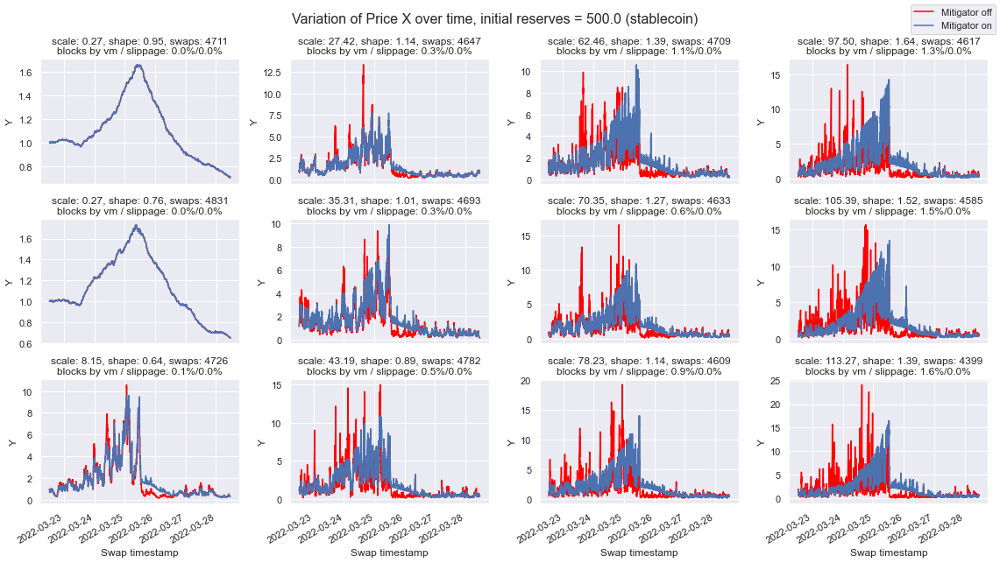

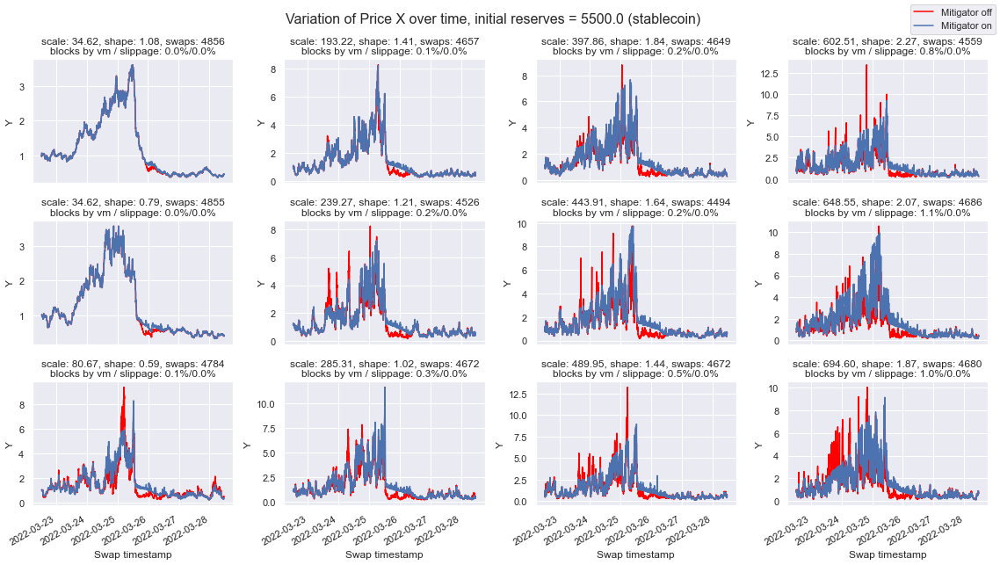

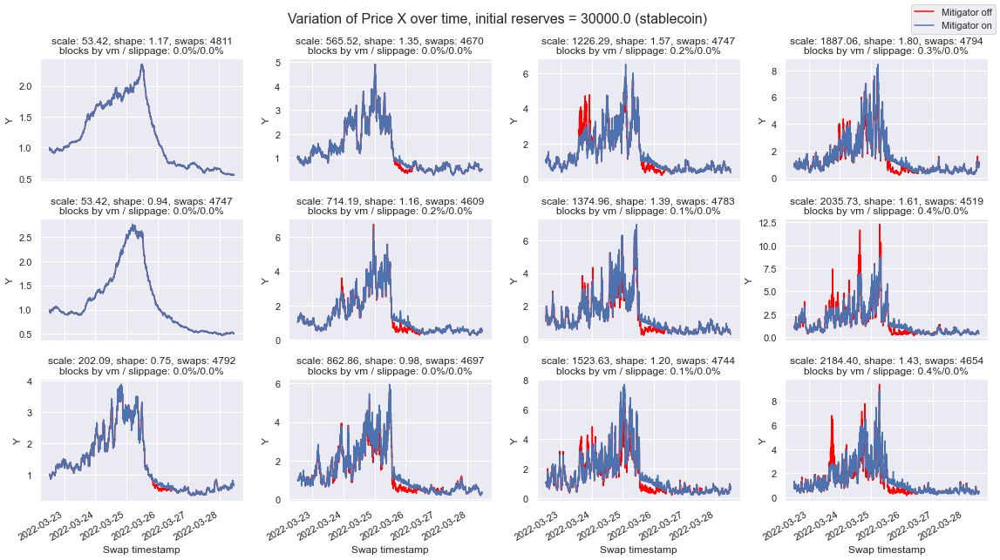

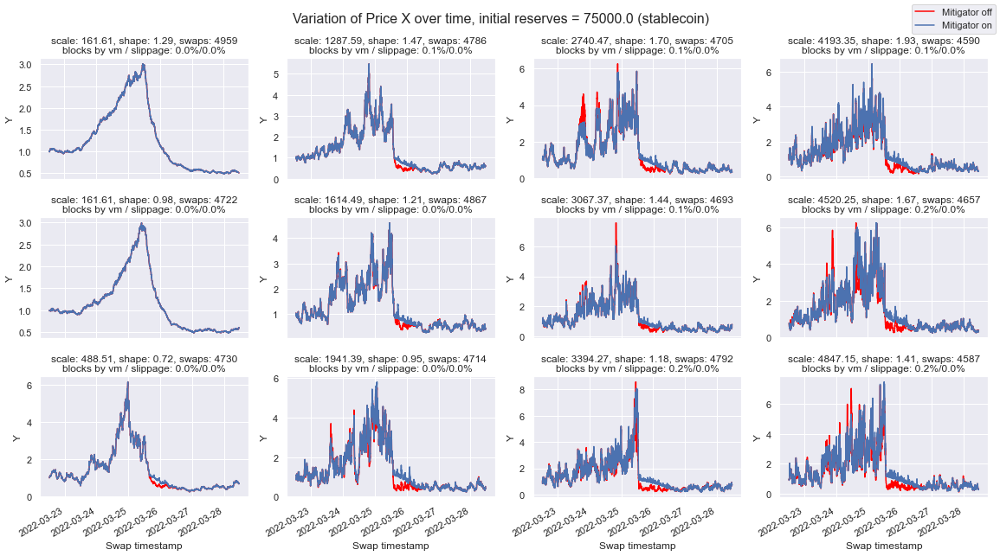

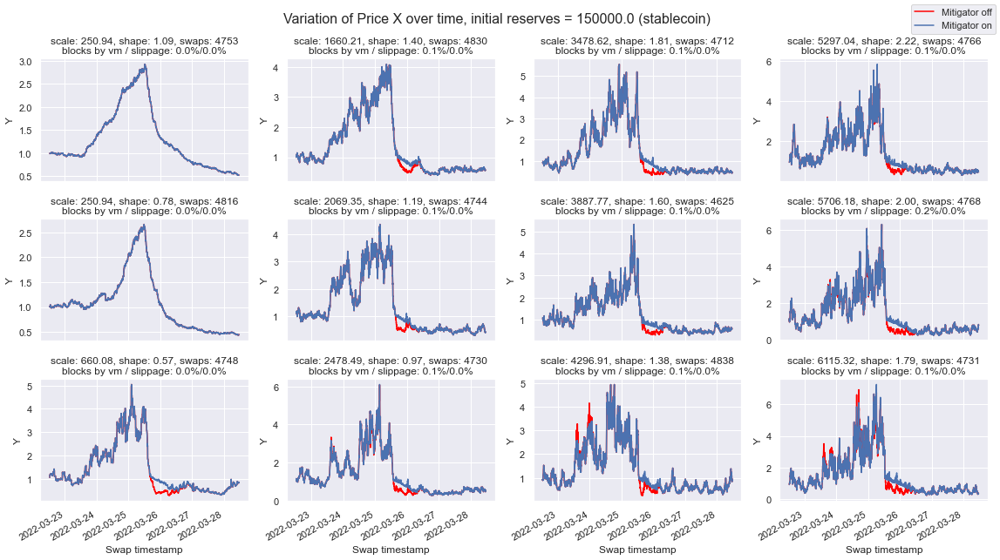

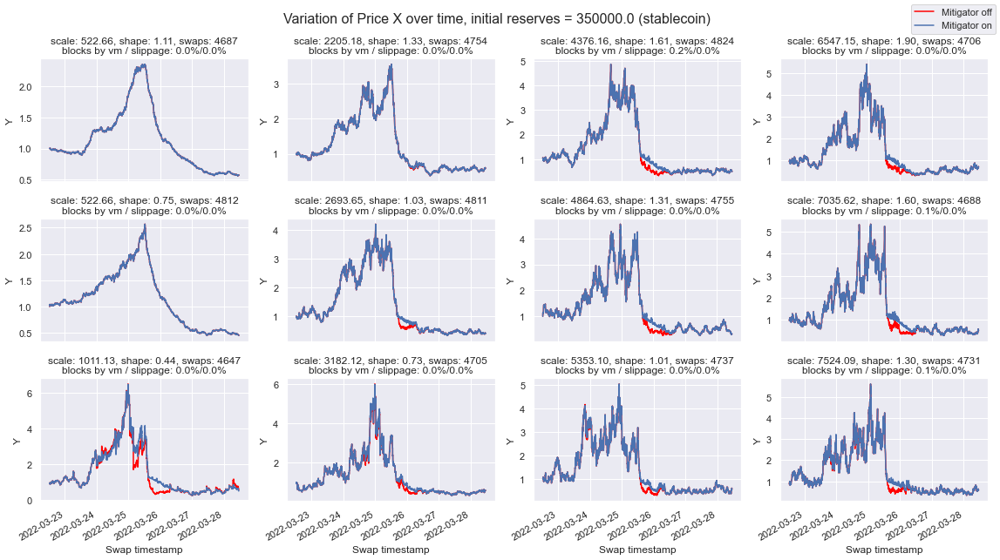

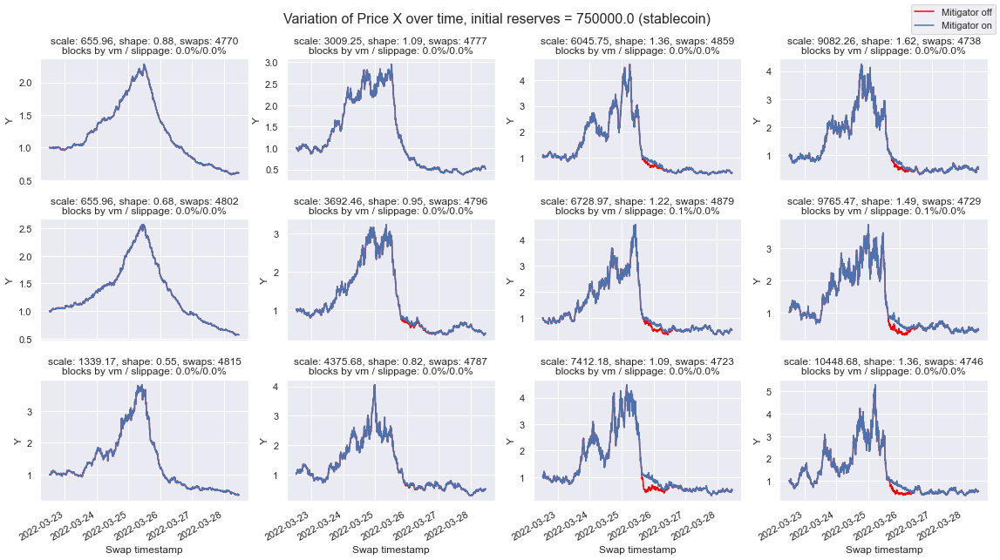

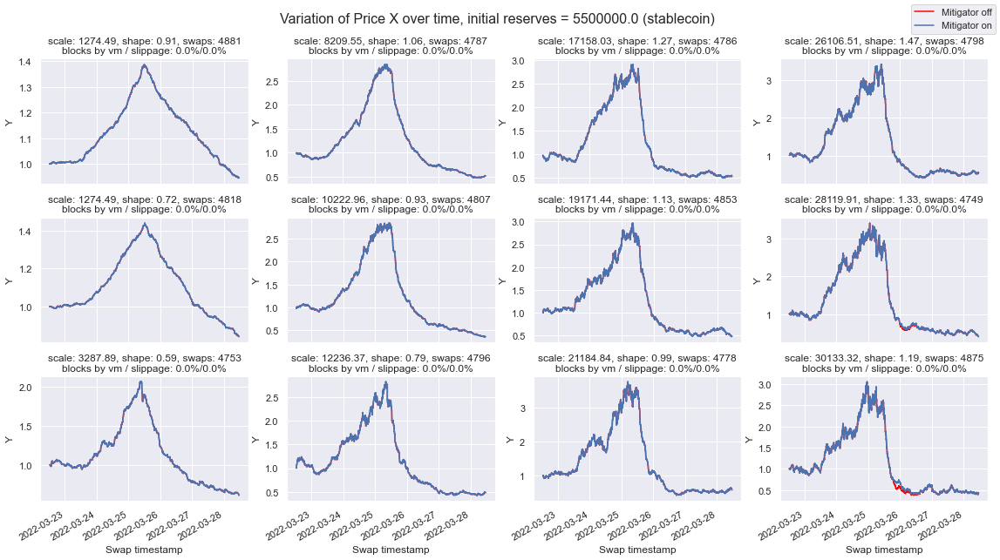

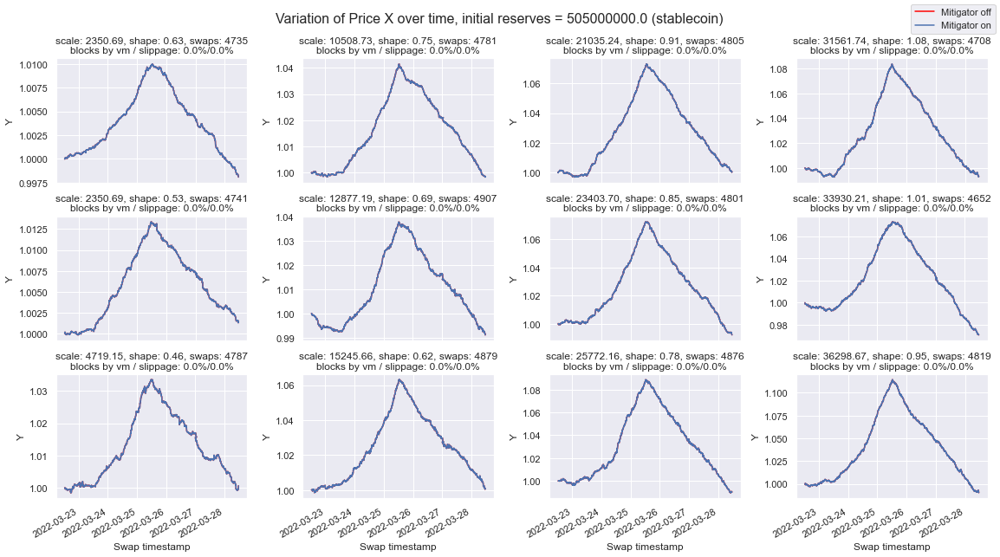

In [75]:
import matplotlib.pyplot as plt
import warnings


filtered_stats_df.sort_values(by=['initial_reserve_usd', 'scale', 'shape'], inplace=True, ascending=[True, True, False])
reserve_groups = filtered_stats_df.groupby('initial_reserve_usd')

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    for name, curr_reserve_stats_df in reserve_groups:
        N = len(curr_reserve_stats_df)
        COLS = 4
        ROWS = N//COLS + (N%COLS != 0)

        fig, ax = plt.subplots(ROWS, COLS, figsize=(COLS*4, ROWS*3))
        axes = ax.ravel()
        axes = axes.reshape(ROWS, COLS).T.ravel()

        i = 0
        for index, row in curr_reserve_stats_df.iterrows():
            ax = axes[i]
            
            scale, shape, initial_reserves_usd = row['scale'], row['shape'], row['initial_reserve_usd']
            blocks, blocks_vm, blocks_slippage, count = row['blocked_transactions'], row['blocked_by_volatility_mitigator'], row['blocked_exceeded_slippage'], row['count']

            df0, df1 = simulations[row['sim_index'] - 1], simulations[row['sim_index']]
            plot_price_variation(ax, df0, df1)
            show_title(ax, row, i==0)
            #ax.set_xlim(simulations[row['sim_index'] - 1].transaction_timestamp.min(), simulations[row['sim_index'] - 1].transaction_timestamp.min() + datetime.timedelta(hours=1))
            #ax.set_ylim(0, 0.001)
        
            i += 1

        fig.suptitle(f'Variation of Price {X_NAME} over time, initial reserves = {name} (stablecoin)', fontsize=16)
        fig.tight_layout()


In [90]:
df = simulations[5].copy()

In [93]:
pd.set_option('max_rows', 5000)
df

,id,token_in,token_out,token_in_amount,token_out_amount_min,token_out_amount,system_fee,mitigator_check_status,oracle_amount_out,oracle_price,out_amount_diff,slice_factor,slice_factor_curve,status,block_number,block_timestamp,transaction_timestamp,txd,sender,to,sequence_swap_cnt,attempt_cnt,desired_token_in_amount,Unnamed: 0_before,transaction_id,reserve_X_before,reserve_Y_before,k_before,price_X_cumulative_before,price_Y_cumulative_before,is_volatility_mitigator_on_before,Unnamed: 0,reserve_X,reserve_Y,k,price_X_cumulative,price_Y_cumulative,is_volatility_mitigator_on,X_price,price_diff
0,05127dda-1c16-4db8-a43d-dd962df61171,X,Y,97.807256,0.0,80.942946,0.323772,CHECKED,97.345733,0.995281,18.0,20.0,80.0,SUCCESS,5777.0,2022-03-22 12:35:18,2022-03-22 12:35:13,05127dda-1c16-4db8-a43d-dd962df61171,NaN,NaN,0,0,97807256492369080000,518,05127dda-1c16-4db8-a43d-dd962df61171,500.755606,499.542299,2.501486e+05,86257,87055,True,518,598.562863,418.275581,2.503642e+05,86257,87055,True,0.698800,-0.299503
1,0e44b00b-a90e-4780-a612-a3c27a3b515a,X,Y,11.478914,0.0,7.793287,0.031173,CHECKED,11.421741,0.995019,37.0,2.0,2.0,SUCCESS,5782.0,2022-03-22 12:36:33,2022-03-22 12:36:26,0e44b00b-a90e-4780-a612-a3c27a3b515a,NaN,NaN,0,0,11478914287620125000,519,0e44b00b-a90e-4780-a612-a3c27a3b515a,598.562863,418.275581,2.503642e+05,86309,87162,True,519,610.041777,410.451121,2.503923e+05,86309,87162,True,0.672825,-0.037171
2,82781afd-c7da-4523-88b9-dec602ba0236,X,Y,72.725445,0.0,43.328455,0.173314,CHECKED,72.346668,0.994792,50.0,12.0,36.0,SUCCESS,5786.0,2022-03-22 12:37:33,2022-03-22 12:37:33,82781afd-c7da-4523-88b9-dec602ba0236,NaN,NaN,0,0,129289680586123000000,520,82781afd-c7da-4523-88b9-dec602ba0236,610.041777,410.451121,2.503923e+05,86350,87251,True,520,682.767222,366.949352,2.505410e+05,86350,87251,True,0.537444,-0.201212
3,11448ae1-6ad2-42d7-923e-f72d5bab63a9,Y,X,51.055429,0.0,82.660745,0.204222,CHECKED,51.365326,1.006070,46.0,14.0,42.0,SUCCESS,5790.0,2022-03-22 12:38:33,2022-03-22 12:38:25,11448ae1-6ad2-42d7-923e-f72d5bab63a9,NaN,NaN,0,0,68073905766704510000,521,11448ae1-6ad2-42d7-923e-f72d5bab63a9,682.767222,366.949352,2.505410e+05,86382,87363,True,521,600.106477,417.800560,2.507248e+05,86382,87363,True,0.696211,0.295410
4,e7400cb7-6efe-44fa-8cfd-26e5da4f8bcb,X,Y,77.225014,0.0,47.212433,0.188850,CHECKED,76.773503,0.994153,47.0,13.0,39.0,SUCCESS,5796.0,2022-03-22 12:40:03,2022-03-22 12:40:00,e7400cb7-6efe-44fa-8cfd-26e5da4f8bcb,NaN,NaN,0,0,77225014183210150000,522,e7400cb7-6efe-44fa-8cfd-26e5da4f8bcb,600.106477,417.800560,2.507248e+05,86444,87492,True,522,677.331491,370.399277,2.508831e+05,86444,87492,True,0.546851,-0.214533
5,4d8daa4e-9a79-40d9-80f5-1430ef934d71,X,Y,69.384298,0.0,34.104754,0.136419,CHECKED,68.918556,0.993288,67.0,11.0,33.0,SUCCESS,5807.0,2022-03-22 12:42:48,2022-03-22 12:42:41,4d8daa4e-9a79-40d9-80f5-1430ef934d71,NaN,NaN,0,0,219288644039133800000,523,4d8daa4e-9a79-40d9-80f5-1430ef934d71,677.331491,370.399277,2.508831e+05,86535,87794,True,523,746.715789,336.158105,2.510146e+05,86535,87794,True,0.450182,-0.176773
6,1e0a03eb-dee4-4828-b665-e3bb4fd8314b,X,Y,53.768883,0.0,22.369104,0.089476,CHECKED,53.392552,0.993001,81.0,8.0,16.0,SUCCESS,5810.0,2022-03-22 12:43:33,2022-03-22 12:43:23,1e0a03eb-dee4-4828-b665-e3bb4fd8314b,NaN,NaN,0,0,71691843659322100000,524,1e0a03eb-dee4-4828-b665-e3bb4fd8314b,746.715789,336.158105,2.510146e+05,86555,87894,True,524,800.484672,313.699524,2.511117e+05,86555,87894,True,0.391887,-0.129492
7,51ef537b-ed09-4cab-9aa1-8f0c01dc9f10,X,Y,23.029473,0.0,8.687273,0.034749,CHECKED,22.829444,0.991314,89.0,3.0,3.0,SUCCESS,5826.0,2022-03-22 12:47:33,2022-03-22 12:47:19,51ef537b-ed09-4cab-9aa1-8f0c01dc9f10,NaN,NaN,0,0,23029473045068684000,525,51ef537b-ed09-4cab-9aa1-8f0c01dc9f10,800.484672,313.699524,2.511117e+05,86649,88506,True,525,823.514145,304.977502,2.511533e+05,86649,88506,True,0.370337,-0.054991
8,2271d40b-1741-4ab3-a76b-e15717dea9dd,X,Y,24.128521,0.0,8.596953,0.034388,CHECKED,23.916318,0.991205,94.0,3.0,3.0,SUCCESS,

In [76]:
def plot_price_impact(ax, swaps0_df, swaps1_df):
    ax.plot_date(data=swaps0_df, x='transaction_timestamp', y='price_diff', linestyle='solid', color='red', marker=None, label='Volatility mitigator off')
    ax.plot_date(data=swaps1_df, x='transaction_timestamp', y='price_diff', linestyle='solid', marker=None, label='Volatility mitigator on')

    ax.set_xlabel('Swap timestamp')
    ax.set_ylim(-1, 1)
    ax.set_ylabel(Y_NAME)

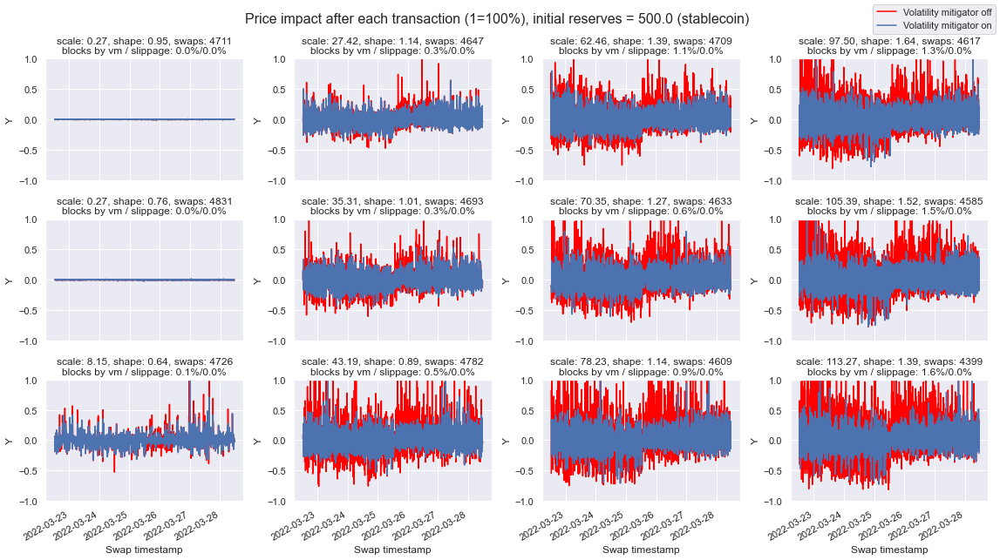

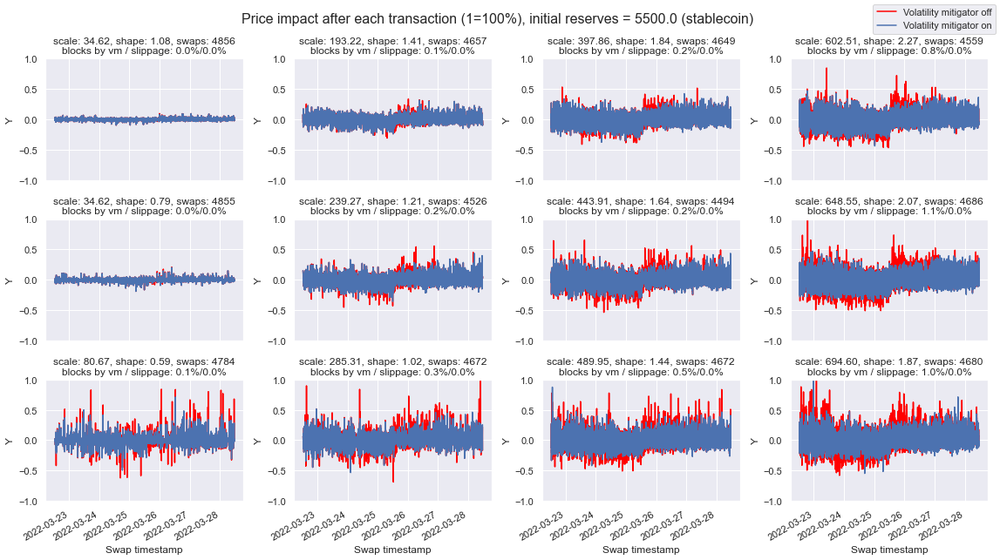

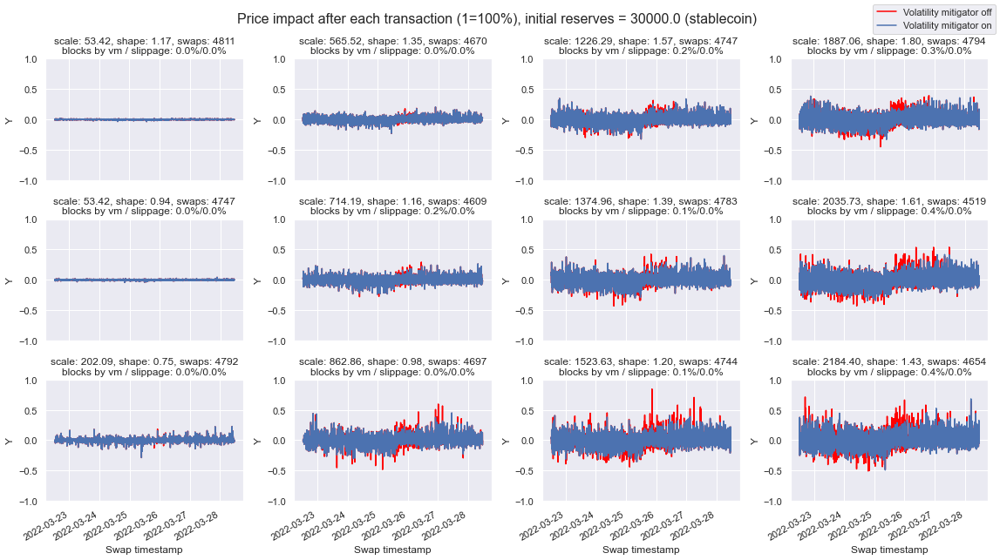

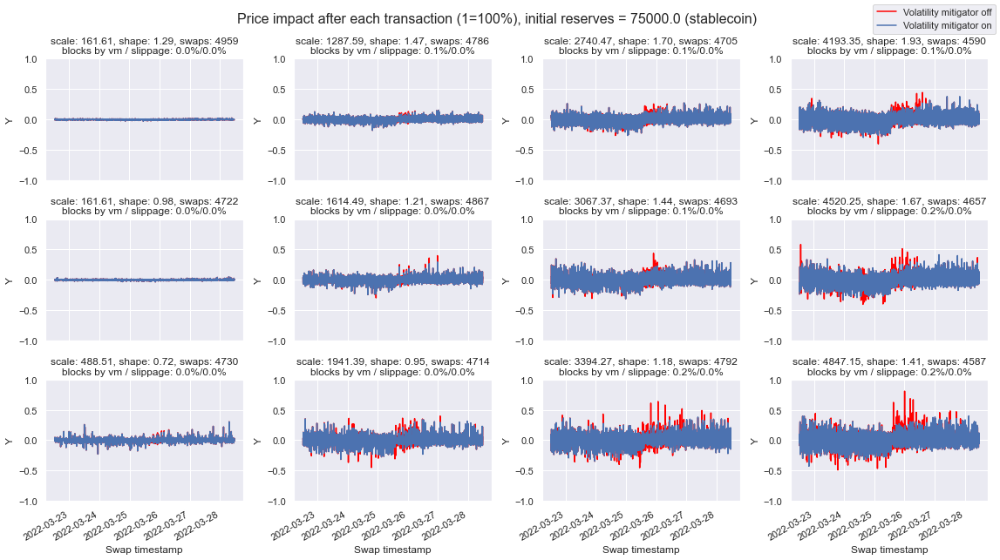

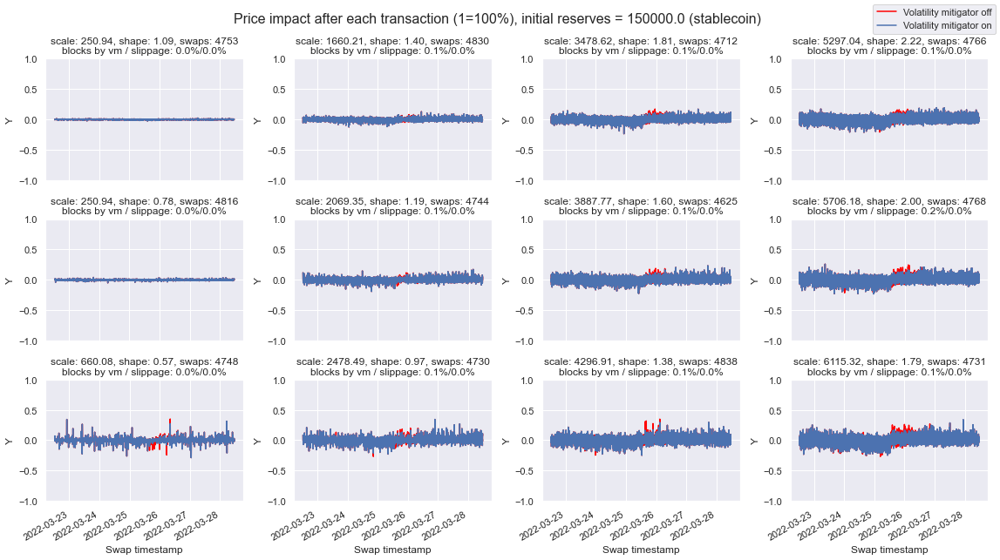

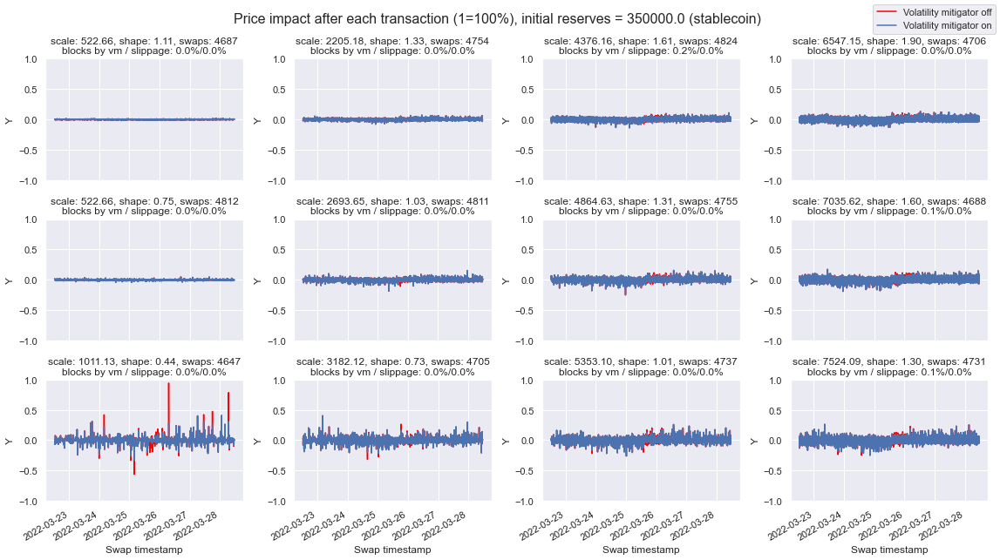

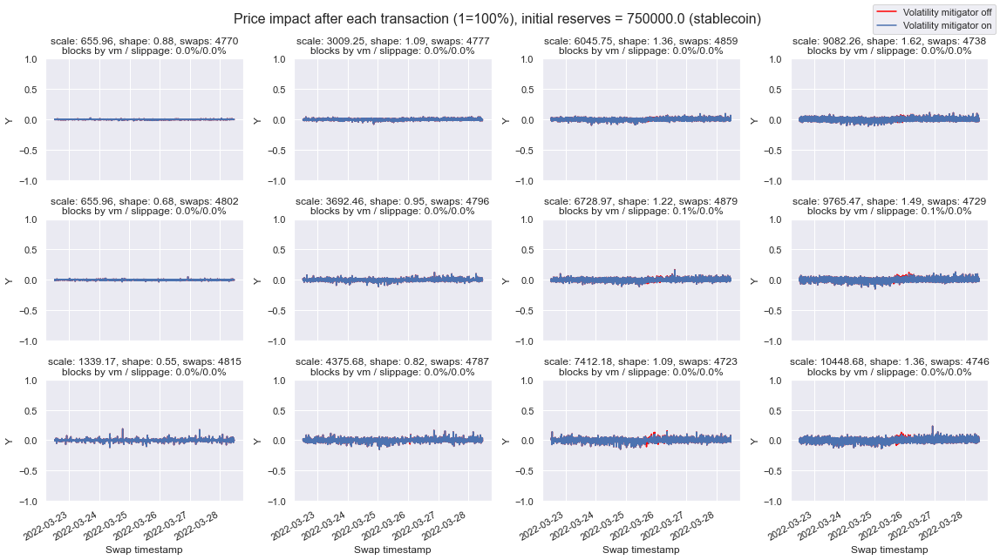

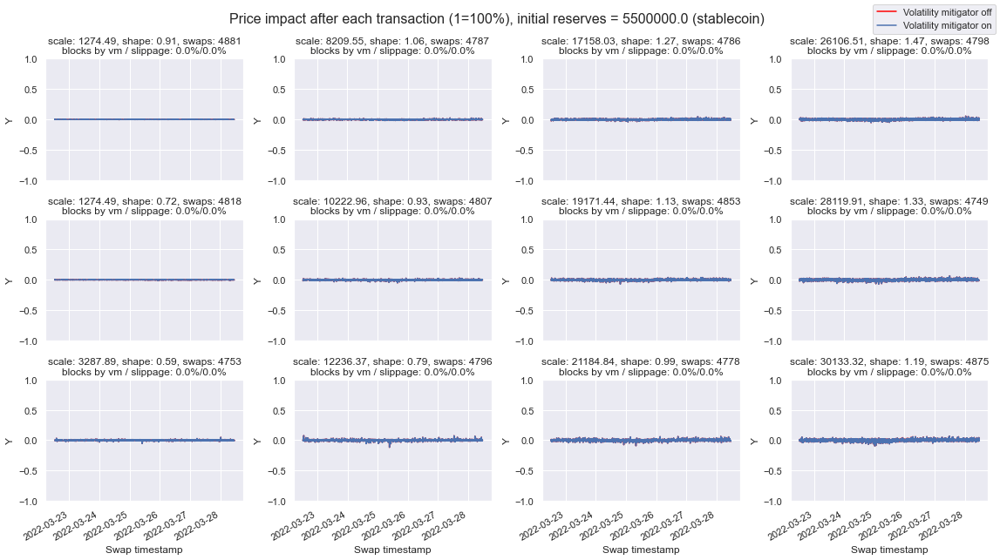

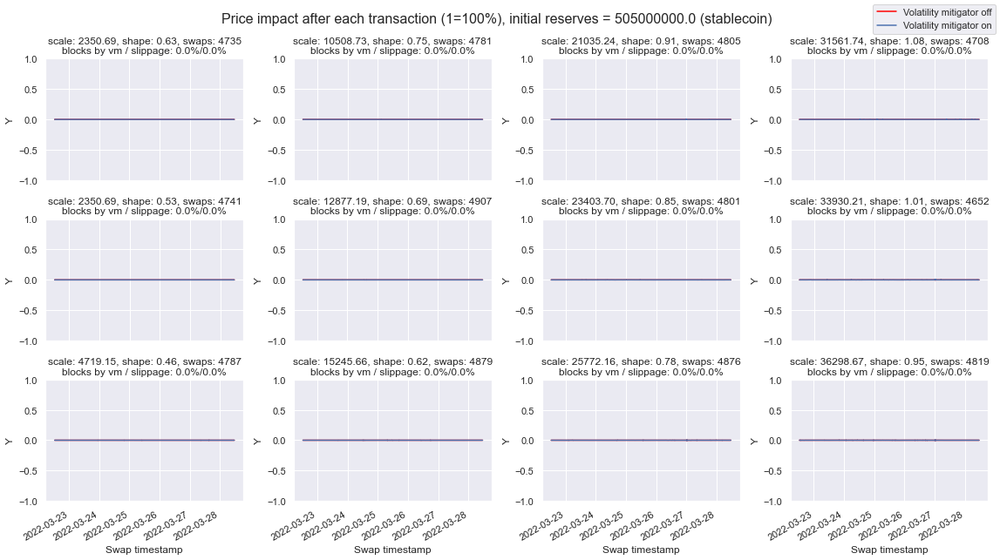

In [77]:
filtered_stats_df.sort_values(by=['initial_reserve_usd', 'scale', 'shape'], inplace=True, ascending=[True, True, False])
reserve_groups = filtered_stats_df.groupby('initial_reserve_usd')

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    for name, curr_reserve_stats_df in reserve_groups:
        N = len(curr_reserve_stats_df)
        COLS = 4
        ROWS = N//COLS + (N%COLS != 0)

        fig, ax = plt.subplots(ROWS, COLS, figsize=(COLS*4, ROWS*3))
        axes = ax.ravel()
        axes = axes.reshape(ROWS, COLS).T.ravel()

        i = 0
        for index, row in curr_reserve_stats_df.iterrows():
            ax = axes[i]
            
            scale, shape, initial_reserves_usd, blocks, count = row['scale'], row['shape'], row['initial_reserve_usd'], row['blocked_transactions'], row['count']

            df0, df1 = simulations[row['sim_index'] - 1], simulations[row['sim_index']]
            plot_price_impact(ax, df0, df1)
            show_title(ax, row, i==0)

            i += 1

        fig.suptitle(f'Price impact after each transaction (1=100%), initial reserves = {name} (stablecoin)', fontsize=16)
        fig.tight_layout()


In [78]:
def plot_reserves(ax, swaps0_df, swaps1_df):
    ax.plot(swaps1_df.transaction_timestamp, swaps1_df.reserve_X, label='reserve X mitigator enabled')

    ax.plot(swaps0_df.transaction_timestamp, swaps0_df.reserve_Y, color='red', label='reserve Y (stablecoin) mitigator off')
    ax.plot(swaps1_df.transaction_timestamp, swaps1_df.reserve_Y, color='orange', label='reserve Y (stablecoin) mitigator enabled')

   # ax.set_title(f'Variation of Price X ({X_NAME}) over time')
  #  ax.set_ylim(100000, 300000)
   # ax.set_xlabel('Swap timestamp')
  #  ax.set_ylabel(Y_NAME)


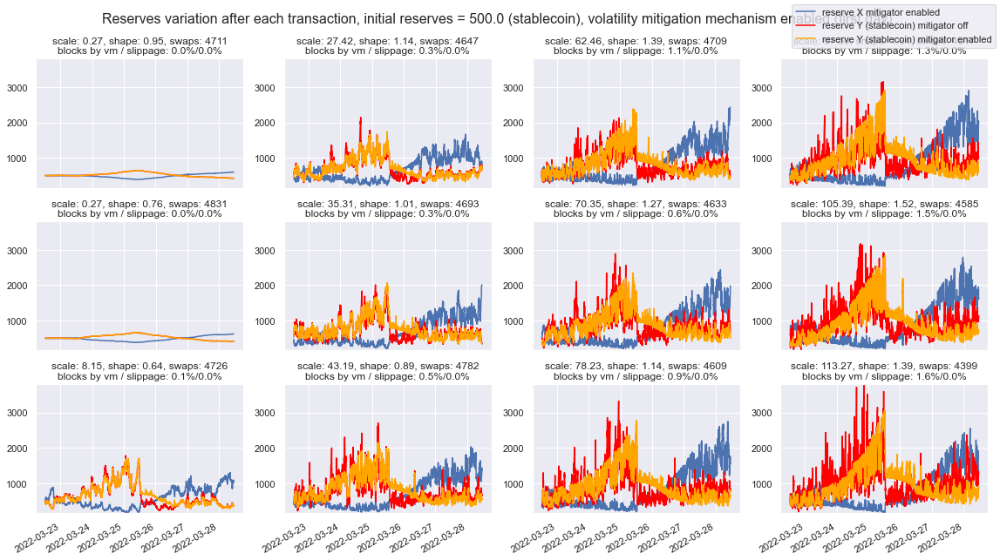

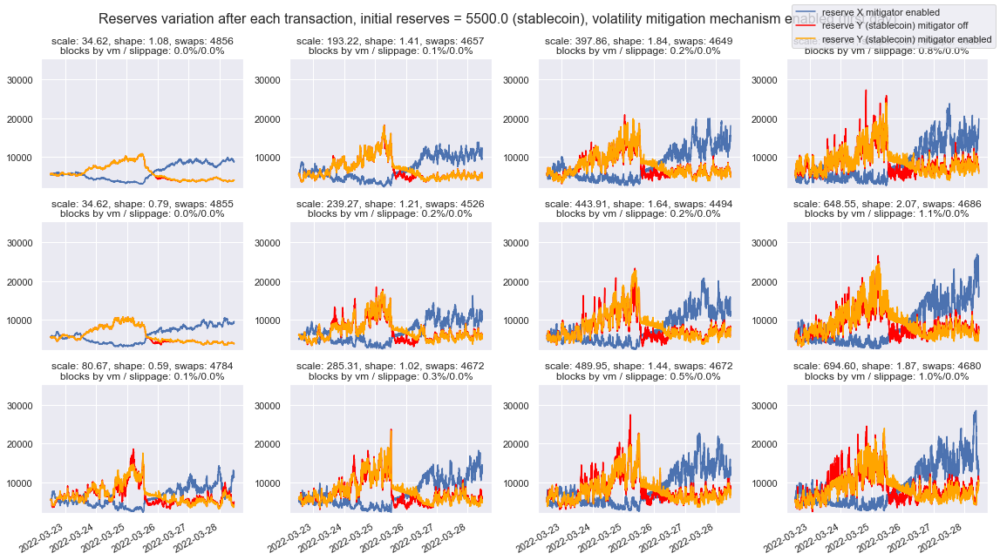

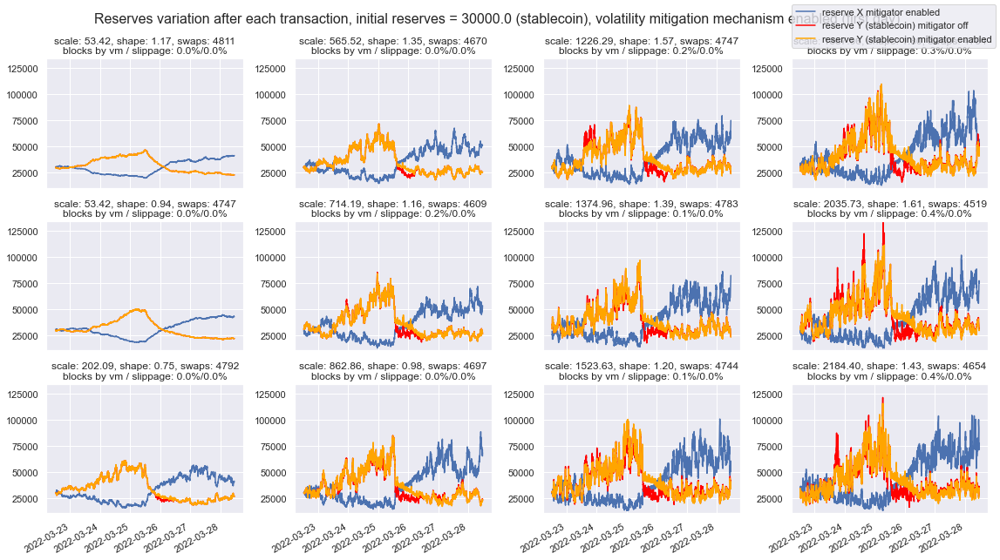

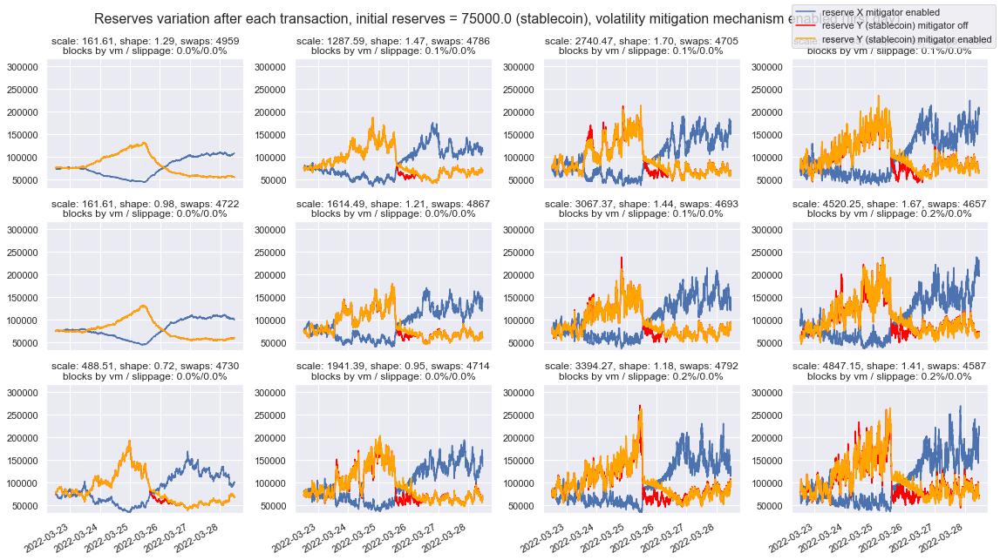

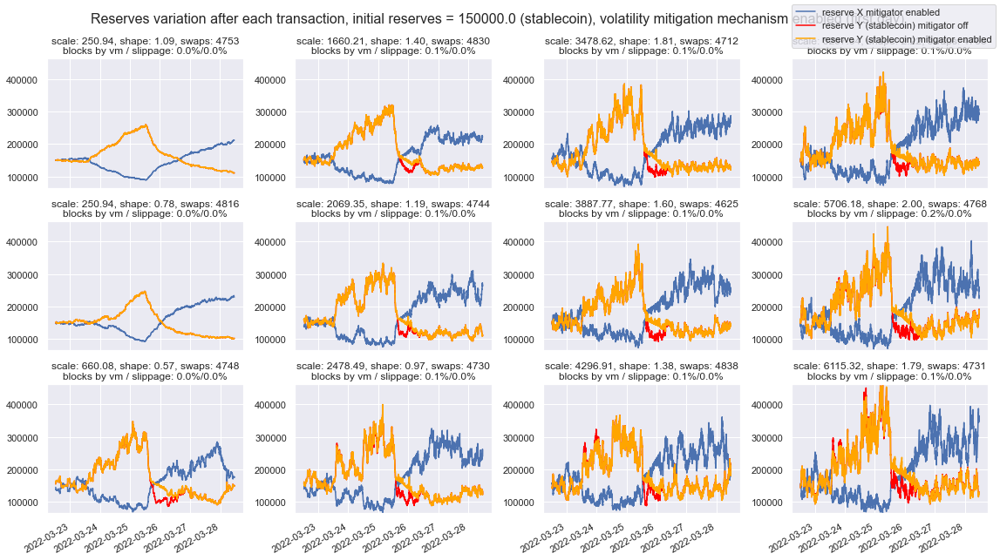

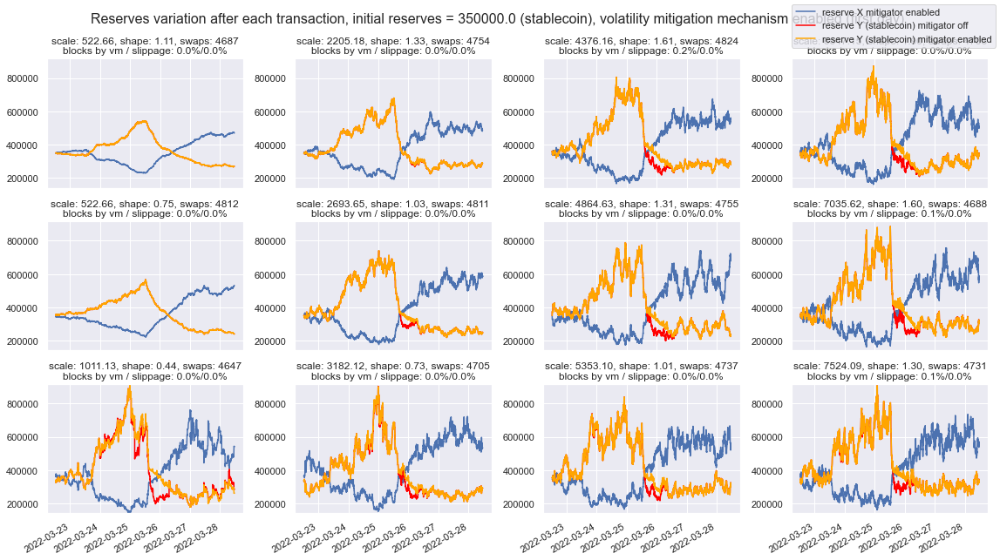

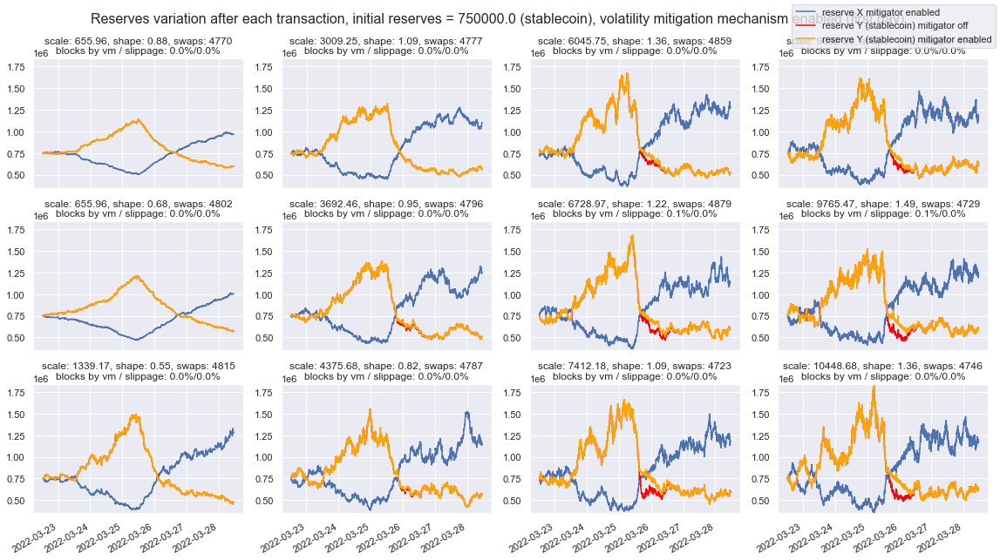

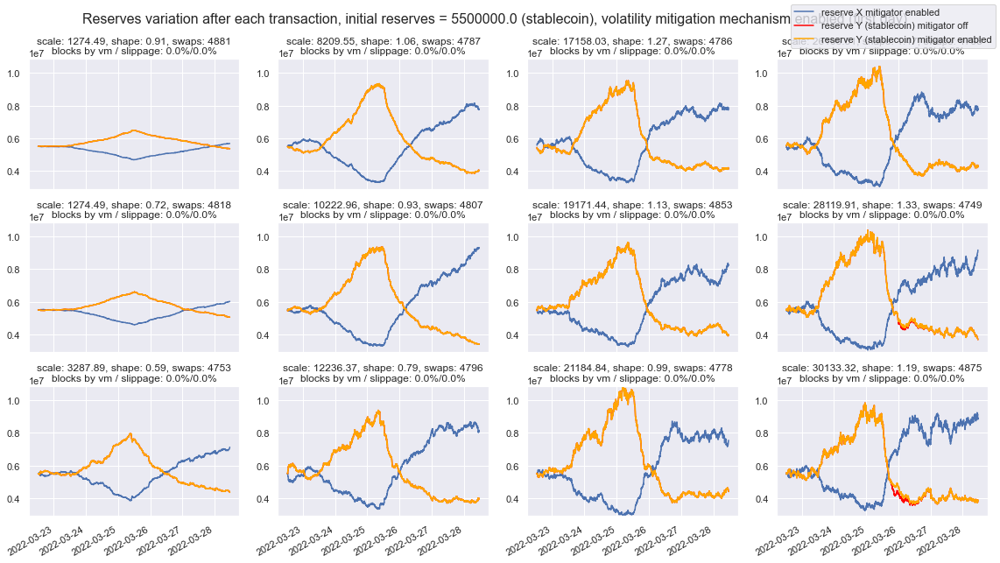

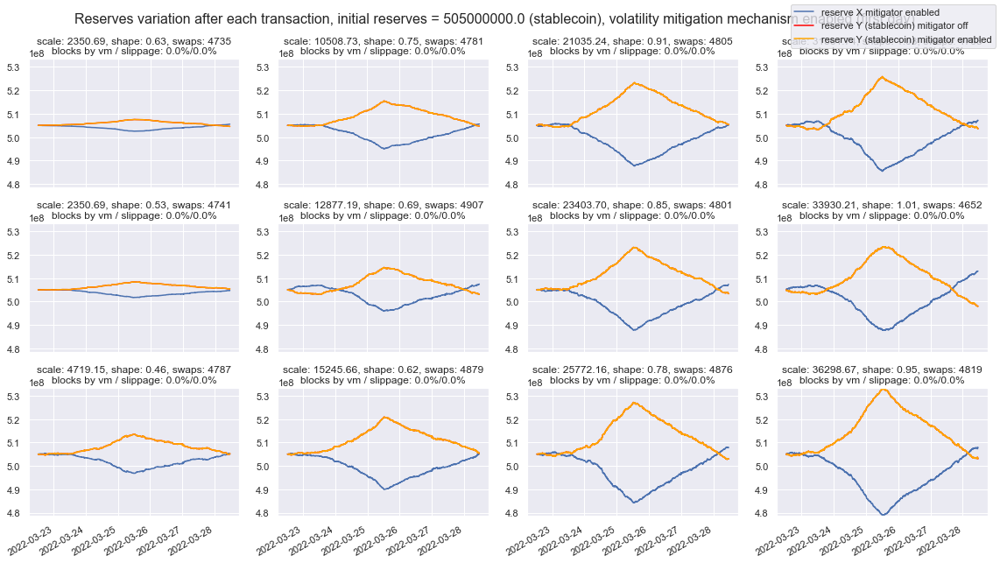

In [79]:
filtered_stats_df.sort_values(by=['initial_reserve_usd', 'scale', 'shape'], inplace=True, ascending=[True, True, False])
reserve_groups = filtered_stats_df.groupby('initial_reserve_usd')

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    for name, curr_reserve_stats_df in reserve_groups:
        N = len(curr_reserve_stats_df)
        COLS = 4
        ROWS = N//COLS + (N%COLS != 0)

        fig, ax = plt.subplots(ROWS, COLS, figsize=(COLS*4, ROWS*3))
        axes = ax.ravel()
        axes = axes.reshape(ROWS, COLS).T.ravel()

        i = 0
        
        x_reserve_limits = [[simulations[row['sim_index'] - 1].reserve_X.min(), simulations[row['sim_index'] - 1].reserve_X.max()] for _, row in curr_reserve_stats_df.iterrows()]
        y_reserve_limits = [[simulations[row['sim_index'] - 1].reserve_Y.min(), simulations[row['sim_index'] - 1].reserve_Y.max()] for _, row in curr_reserve_stats_df.iterrows()]
        
        reserve_limits = np.concatenate([x_reserve_limits, y_reserve_limits])
      #  print(reserve_limits)
        y_axis_min, y_axis_max = reserve_limits.min(), reserve_limits.max()
        
        for index, row in curr_reserve_stats_df.iterrows():
            ax = axes[i]
            scale, shape, initial_reserves_usd, blocks, count = row['scale'], row['shape'], row['initial_reserve_usd'], row['blocked_transactions'], row['count']

            df0, df1 = simulations[row['sim_index'] - 1], simulations[row['sim_index']]
            plot_reserves(ax, df0, df1)
            #ax.set_xlim(simulations[row['sim_index'] - 1].transaction_timestamp.min(), simulations[row['sim_index'] - 1].transaction_timestamp.min() + datetime.timedelta(hours=24))
            show_title(ax, row, i==0)
            
            ax.set_ylim(y_axis_min, y_axis_max)

            i += 1

        fig.suptitle(f'Reserves variation after each transaction, initial reserves = {name} (stablecoin), volatility mitigation mechanism enabled (first day)', fontsize=16)
        fig.tight_layout()


In [80]:
def plot_blocked_datetime(ax, swaps0_df, swaps_df, scale, shape, blocks, count, is_first, resample_interval='1h'):
    success_df = swaps_df[swaps_df.status == 'SUCCESS']
    blocked_df = swaps_df[swaps_df.status != 'SUCCESS']
    
    blocked_df.index = blocked_df.transaction_timestamp
    success_df.index = success_df.transaction_timestamp
    
    success_s = success_df.resample(resample_interval).size()
    blocked_s = blocked_df.resample(resample_interval).size()
    
    ax.plot_date(x=success_s.index, y=success_s, linestyle='solid', marker=None, label='Success', color='green')
    ax.plot_date(x=blocked_s.index, y=blocked_s, linestyle='solid', marker=None, label='Blocked', color='red')

  #  ax.set_title(f'Variation of Price X ({X_NAME}) over time')
    #ax.set_ylim(0, 3)
    ax.set_xlabel('Time')
    ax.set_ylabel(Y_NAME)
    ax.set_title(f'scale = {scale}, shape = {shape}, blocks: {blocks} / {count}') #todo: iloc may differ from simulatuions df
    fig.autofmt_xdate()

    if is_first:
        fig.legend()

In [81]:
def plot_blocked_datetime(ax, swaps0_df, swaps_df,resample_interval='1h'):
    success_x_df = swaps_df[(swaps_df.status == 'SUCCESS') & ((swaps_df.token_in == 'X'))]
    success_y_df = swaps_df[(swaps_df.status == 'SUCCESS') & ((swaps_df.token_in == 'Y'))]
        
    blocked_x_df = swaps_df[(swaps_df.status != 'SUCCESS') & ((swaps_df.token_in == 'X'))]
    blocked_y_df = swaps_df[(swaps_df.status != 'SUCCESS') & ((swaps_df.token_in == 'Y'))]
    
    blocked_x_df.index = blocked_x_df.transaction_timestamp
    blocked_y_df.index = blocked_y_df.transaction_timestamp
    success_x_df.index = success_x_df.transaction_timestamp
    success_y_df.index = success_y_df.transaction_timestamp
    
    blocked_x_df.loc[success_y_df.index.max()] = None
    blocked_y_df.loc[success_y_df.index.max()] = None
    blocked_x_df.loc[success_y_df.index.min()] = None
    blocked_y_df.loc[success_y_df.index.min()] = None
    
    success_x_s = success_x_df.resample(resample_interval).size()
    success_y_s = success_y_df.resample(resample_interval).size()

    blocked_x_s = blocked_x_df.resample(resample_interval).size()
    blocked_y_s = blocked_y_df.resample(resample_interval).size()
    
    blocked_x_s.iloc[-1] -=1
    blocked_y_s.iloc[-1] -=1

    blocked_x_s.iloc[0] -=1
    blocked_y_s.iloc[0] -=1
    
    ratio_blocked_x = blocked_x_s / (success_x_s + blocked_x_s)
    ratio_blocked_y = blocked_y_s / (success_y_s + blocked_y_s)
    ratio_blocked_x[(success_x_s + blocked_x_s) == 0] = 0
    ratio_blocked_y[(success_y_s + blocked_y_s) == 0] = 0

    ax.plot_date(x=ratio_blocked_x.index, y=ratio_blocked_x, linestyle='solid', marker=None, label='in X', )
    ax.plot_date(x=ratio_blocked_y.index, y=ratio_blocked_y, linestyle='solid', marker=None, label='in Y', color='orange')

  #  ax.set_title(f'Variation of Price X ({X_NAME}) over time')
    #ax.set_ylim(0, 3)
    ax.set_xlabel('Time')
    ax.set_ylabel(Y_NAME)
